# DonorsChoose

<p>
DonorsChoose.org receives hundreds of thousands of project proposals each year for classroom projects in need of funding. Right now, a large number of volunteers is needed to manually screen each submission before it's approved to be posted on the DonorsChoose.org website.
</p>
<p>
    Next year, DonorsChoose.org expects to receive close to 500,000 project proposals. As a result, there are three main problems they need to solve:
<ul>
<li>
    How to scale current manual processes and resources to screen 500,000 projects so that they can be posted as quickly and as efficiently as possible</li>
    <li>How to increase the consistency of project vetting across different volunteers to improve the experience for teachers</li>
    <li>How to focus volunteer time on the applications that need the most assistance</li>
    </ul>
</p>    
<p>
The goal of the competition is to predict whether or not a DonorsChoose.org project proposal submitted by a teacher will be approved, using the text of project descriptions as well as additional metadata about the project, teacher, and school. DonorsChoose.org can then use this information to identify projects most likely to need further review before approval.
</p>

## About the DonorsChoose Data Set

The `train.csv` data set provided by DonorsChoose contains the following features:

Feature | Description 
----------|---------------
**`project_id`** | A unique identifier for the proposed project. **Example:** `p036502`   
**`project_title`**    | Title of the project. **Examples:**<br><ul><li><code>Art Will Make You Happy!</code></li><li><code>First Grade Fun</code></li></ul> 
**`project_grade_category`** | Grade level of students for which the project is targeted. One of the following enumerated values: <br/><ul><li><code>Grades PreK-2</code></li><li><code>Grades 3-5</code></li><li><code>Grades 6-8</code></li><li><code>Grades 9-12</code></li></ul>  
 **`project_subject_categories`** | One or more (comma-separated) subject categories for the project from the following enumerated list of values:  <br/><ul><li><code>Applied Learning</code></li><li><code>Care &amp; Hunger</code></li><li><code>Health &amp; Sports</code></li><li><code>History &amp; Civics</code></li><li><code>Literacy &amp; Language</code></li><li><code>Math &amp; Science</code></li><li><code>Music &amp; The Arts</code></li><li><code>Special Needs</code></li><li><code>Warmth</code></li></ul><br/> **Examples:** <br/><ul><li><code>Music &amp; The Arts</code></li><li><code>Literacy &amp; Language, Math &amp; Science</code></li>  
  **`school_state`** | State where school is located ([Two-letter U.S. postal code](https://en.wikipedia.org/wiki/List_of_U.S._state_abbreviations#Postal_codes)). **Example:** `WY`
**`project_subject_subcategories`** | One or more (comma-separated) subject subcategories for the project. **Examples:** <br/><ul><li><code>Literacy</code></li><li><code>Literature &amp; Writing, Social Sciences</code></li></ul> 
**`project_resource_summary`** | An explanation of the resources needed for the project. **Example:** <br/><ul><li><code>My students need hands on literacy materials to manage sensory needs!</code</li></ul> 
**`project_essay_1`**    | First application essay<sup>*</sup>  
**`project_essay_2`**    | Second application essay<sup>*</sup> 
**`project_essay_3`**    | Third application essay<sup>*</sup> 
**`project_essay_4`**    | Fourth application essay<sup>*</sup> 
**`project_submitted_datetime`** | Datetime when project application was submitted. **Example:** `2016-04-28 12:43:56.245`   
**`teacher_id`** | A unique identifier for the teacher of the proposed project. **Example:** `bdf8baa8fedef6bfeec7ae4ff1c15c56`  
**`teacher_prefix`** | Teacher's title. One of the following enumerated values: <br/><ul><li><code>nan</code></li><li><code>Dr.</code></li><li><code>Mr.</code></li><li><code>Mrs.</code></li><li><code>Ms.</code></li><li><code>Teacher.</code></li></ul>  
**`teacher_number_of_previously_posted_projects`** | Number of project applications previously submitted by the same teacher. **Example:** `2` 

<sup>*</sup> See the section <b>Notes on the Essay Data</b> for more details about these features.

Additionally, the `resources.csv` data set provides more data about the resources required for each project. Each line in this file represents a resource required by a project:

Feature | Description 
----------|---------------
**`id`** | A `project_id` value from the `train.csv` file.  **Example:** `p036502`   
**`description`** | Desciption of the resource. **Example:** `Tenor Saxophone Reeds, Box of 25`   
**`quantity`** | Quantity of the resource required. **Example:** `3`   
**`price`** | Price of the resource required. **Example:** `9.95`   

**Note:** Many projects require multiple resources. The `id` value corresponds to a `project_id` in train.csv, so you use it as a key to retrieve all resources needed for a project:

The data set contains the following label (the value you will attempt to predict):

Label | Description
----------|---------------
`project_is_approved` | A binary flag indicating whether DonorsChoose approved the project. A value of `0` indicates the project was not approved, and a value of `1` indicates the project was approved.

### Notes on the Essay Data

<ul>
Prior to May 17, 2016, the prompts for the essays were as follows:
<li>__project_essay_1:__ "Introduce us to your classroom"</li>
<li>__project_essay_2:__ "Tell us more about your students"</li>
<li>__project_essay_3:__ "Describe how your students will use the materials you're requesting"</li>
<li>__project_essay_3:__ "Close by sharing why your project will make a difference"</li>
</ul>


<ul>
Starting on May 17, 2016, the number of essays was reduced from 4 to 2, and the prompts for the first 2 essays were changed to the following:<br>
<li>__project_essay_1:__ "Describe your students: What makes your students special? Specific details about their background, your neighborhood, and your school are all helpful."</li>
<li>__project_essay_2:__ "About your project: How will these materials make a difference in your students' learning and improve their school lives?"</li>
<br>For all projects with project_submitted_datetime of 2016-05-17 and later, the values of project_essay_3 and project_essay_4 will be NaN.
</ul>


In [0]:
!pip install chart_studio 

In [0]:
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

import sqlite3
import pandas as pd
import numpy as np
import nltk
import string
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.metrics import roc_curve, auc
from nltk.stem.porter import PorterStemmer

import re
# Tutorial about Python regular expressions: https://pymotw.com/2/re/
import string
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem.wordnet import WordNetLemmatizer

from gensim.models import Word2Vec
from gensim.models import KeyedVectors
import pickle

from tqdm import tqdm
import os

from chart_studio import plotly
import plotly.offline as offline
import plotly.graph_objs as go
offline.init_notebook_mode()
from collections import Counter

In [0]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## 1.1 Reading Data

In [0]:
project_data = pd.read_csv('/content/drive/My Drive/Assignments_DonorsChoose_2018/train_data.csv')
resource_data = pd.read_csv('/content/drive/My Drive/Assignments_DonorsChoose_2018/resources.csv')

In [0]:
print("Number of data points in train data", project_data.shape)
print('-'*50)
print("The attributes of data :", project_data.columns.values)

Number of data points in train data (109248, 17)
--------------------------------------------------
The attributes of data : ['Unnamed: 0' 'id' 'teacher_id' 'teacher_prefix' 'school_state'
 'project_submitted_datetime' 'project_grade_category'
 'project_subject_categories' 'project_subject_subcategories'
 'project_title' 'project_essay_1' 'project_essay_2' 'project_essay_3'
 'project_essay_4' 'project_resource_summary'
 'teacher_number_of_previously_posted_projects' 'project_is_approved']


In [0]:
# how to replace elements in list python: https://stackoverflow.com/a/2582163/4084039
cols = ['Date' if x=='project_submitted_datetime' else x for x in list(project_data.columns)]


#sort dataframe based on time pandas python: https://stackoverflow.com/a/49702492/4084039
project_data['Date'] = pd.to_datetime(project_data['project_submitted_datetime'])
project_data.drop('project_submitted_datetime', axis=1, inplace=True)
project_data.sort_values(by=['Date'], inplace=True)


# how to reorder columns pandas python: https://stackoverflow.com/a/13148611/4084039
project_data = project_data[cols]


project_data.head(2)

,Unnamed: 0,id,teacher_id,teacher_prefix,school_state,Date,project_grade_category,project_subject_categories,project_subject_subcategories,project_title,project_essay_1,project_essay_2,project_essay_3,project_essay_4,project_resource_summary,teacher_number_of_previously_posted_projects,project_is_approved
55660,8393,p205479,2bf07ba08945e5d8b2a3f269b2b3cfe5,Mrs.,CA,2016-04-27 00:27:36,Grades PreK-2,Math & Science,"Applied Sciences, Health & Life Science",Engineering STEAM into the Primary Classroom,I have been fortunate enough to use the Fairy ...,My students come from a variety of backgrounds...,Each month I try to do several science or STEM...,It is challenging to develop high quality scie...,My students need STEM kits to learn critical s...,53,1
76127,37728,p043609,3f60494c61921b3b43ab61bdde2904df,Ms.,UT,2016-04-27 00:31:25,Grades 3-5,Special Needs,Special Needs,Sensory Tools for Focus,Imagine being 8-9 years old. You're in your th...,"Most of my students have autism, anxiety, anot...",It is tough to do more than one thing at a tim...,When my students are able to calm themselves d...,My students need Boogie Boards for quiet senso...,4,1


In [0]:
print("Number of data points in train data", resource_data.shape)
print(resource_data.columns.values)
resource_data.head(2)

Number of data points in train data (1541272, 4)
['id' 'description' 'quantity' 'price']


,id,description,quantity,price
0,p233245,LC652 - Lakeshore Double-Space Mobile Drying Rack,1,149.00
1,p069063,Bouncy Bands for Desks (Blue support pipes),3,14.95


## 1.2 preprocessing of `project_subject_categories`

In [0]:
catogories = list(project_data['project_subject_categories'].values)
# remove special characters from list of strings python: https://stackoverflow.com/a/47301924/4084039

# https://www.geeksforgeeks.org/removing-stop-words-nltk-python/
# https://stackoverflow.com/questions/23669024/how-to-strip-a-specific-word-from-a-string
# https://stackoverflow.com/questions/8270092/remove-all-whitespace-in-a-string-in-python
cat_list = []
for i in catogories:
    temp = ""
    # consider we have text like this "Math & Science, Warmth, Care & Hunger"
    for j in i.split(','): # it will split it in three parts ["Math & Science", "Warmth", "Care & Hunger"]
        if 'The' in j.split(): # this will split each of the catogory based on space "Math & Science"=> "Math","&", "Science"
            j=j.replace('The','') # if we have the words "The" we are going to replace it with ''(i.e removing 'The')
        j = j.replace(' ','') # we are placeing all the ' '(space) with ''(empty) ex:"Math & Science"=>"Math&Science"
        temp+=j.strip()+" " #" abc ".strip() will return "abc", remove the trailing spaces
        temp = temp.replace('&','_') # we are replacing the & value into 
    cat_list.append(temp.strip())
    
project_data['clean_categories'] = cat_list
project_data.drop(['project_subject_categories'], axis=1, inplace=True)

from collections import Counter
my_counter = Counter()
for word in project_data['clean_categories'].values:
    my_counter.update(word.split())

cat_dict = dict(my_counter)
sorted_cat_dict = dict(sorted(cat_dict.items(), key=lambda kv: kv[1]))


## 1.3 preprocessing of `project_subject_subcategories`

In [0]:
sub_catogories = list(project_data['project_subject_subcategories'].values)
# remove special characters from list of strings python: https://stackoverflow.com/a/47301924/4084039

# https://www.geeksforgeeks.org/removing-stop-words-nltk-python/
# https://stackoverflow.com/questions/23669024/how-to-strip-a-specific-word-from-a-string
# https://stackoverflow.com/questions/8270092/remove-all-whitespace-in-a-string-in-python

sub_cat_list = []
for i in sub_catogories:
    temp = ""
    # consider we have text like this "Math & Science, Warmth, Care & Hunger"
    for j in i.split(','): # it will split it in three parts ["Math & Science", "Warmth", "Care & Hunger"]
        if 'The' in j.split(): # this will split each of the catogory based on space "Math & Science"=> "Math","&", "Science"
            j=j.replace('The','') # if we have the words "The" we are going to replace it with ''(i.e removing 'The')
        j = j.replace(' ','') # we are placeing all the ' '(space) with ''(empty) ex:"Math & Science"=>"Math&Science"
        temp +=j.strip()+" "#" abc ".strip() will return "abc", remove the trailing spaces
        temp = temp.replace('&','_')
    sub_cat_list.append(temp.strip())

project_data['clean_subcategories'] = sub_cat_list
project_data.drop(['project_subject_subcategories'], axis=1, inplace=True)

# count of all the words in corpus python: https://stackoverflow.com/a/22898595/4084039
my_counter = Counter()
for word in project_data['clean_subcategories'].values:
    my_counter.update(word.split())
    
sub_cat_dict = dict(my_counter)
sorted_sub_cat_dict = dict(sorted(sub_cat_dict.items(), key=lambda kv: kv[1]))

## 1.3 Text preprocessing

In [0]:
# merge two column text dataframe: 
project_data["essay"] = project_data["project_essay_1"].map(str) +\
                        project_data["project_essay_2"].map(str) + \
                        project_data["project_essay_3"].map(str) + \
                        project_data["project_essay_4"].map(str)

In [0]:
project_data.head(2)

,Unnamed: 0,id,teacher_id,teacher_prefix,school_state,Date,project_grade_category,project_title,project_essay_1,project_essay_2,project_essay_3,project_essay_4,project_resource_summary,teacher_number_of_previously_posted_projects,project_is_approved,clean_categories,clean_subcategories,essay
55660,8393,p205479,2bf07ba08945e5d8b2a3f269b2b3cfe5,Mrs.,CA,2016-04-27 00:27:36,Grades PreK-2,Engineering STEAM into the Primary Classroom,I have been fortunate enough to use the Fairy ...,My students come from a variety of backgrounds...,Each month I try to do several science or STEM...,It is challenging to develop high quality scie...,My students need STEM kits to learn critical s...,53,1,Math_Science,AppliedSciences Health_LifeScience,I have been fortunate enough to use the Fairy ...
76127,37728,p043609,3f60494c61921b3b43ab61bdde2904df,Ms.,UT,2016-04-27 00:31:25,Grades 3-5,Sensory Tools for Focus,Imagine being 8-9 years old. You're in your th...,"Most of my students have autism, anxiety, anot...",It is tough to do more than one thing at a tim...,When my students are able to calm themselves d...,My students need Boogie Boards for quiet senso...,4,1,SpecialNeeds,SpecialNeeds,Imagine being 8-9 years old. You're in your th...


In [0]:
# printing some random reviews
print(project_data['essay'].values[0])
print("="*50)
print(project_data['essay'].values[150])
print("="*50)
print(project_data['essay'].values[1000])
print("="*50)
print(project_data['essay'].values[20000])
print("="*50)
print(project_data['essay'].values[99999])
print("="*50)

I have been fortunate enough to use the Fairy Tale STEM kits in my classroom as well as the STEM journals, which my students really enjoyed.  I would love to implement more of the Lakeshore STEM kits in my classroom for the next school year as they provide excellent and engaging STEM lessons.My students come from a variety of backgrounds, including language and socioeconomic status.  Many of them don't have a lot of experience in science and engineering and these kits give me the materials to provide these exciting opportunities for my students.Each month I try to do several science or STEM/STEAM projects.  I would use the kits and robot to help guide my science instruction in engaging and meaningful ways.  I can adapt the kits to my current language arts pacing guide where we already teach some of the material in the kits like tall tales (Paul Bunyan) or Johnny Appleseed.  The following units will be taught in the next school year where I will implement these kits: magnets, motion, si

In [0]:
# https://stackoverflow.com/a/47091490/4084039
import re

def decontracted(phrase):
    # specific
    phrase = re.sub(r"won't", "will not", phrase)
    phrase = re.sub(r"can\'t", "can not", phrase)

    # general
    phrase = re.sub(r"n\'t", " not", phrase)
    phrase = re.sub(r"\'re", " are", phrase)
    phrase = re.sub(r"\'s", " is", phrase)
    phrase = re.sub(r"\'d", " would", phrase)
    phrase = re.sub(r"\'ll", " will", phrase)
    phrase = re.sub(r"\'t", " not", phrase)
    phrase = re.sub(r"\'ve", " have", phrase)
    phrase = re.sub(r"\'m", " am", phrase)
    return phrase

In [0]:
sent = decontracted(project_data['essay'].values[20000])
print(sent)
print("="*50)

\"A person is a person, no matter how small.\" (Dr.Seuss) I teach the smallest students with the biggest enthusiasm for learning. My students learn in many different ways using all of our senses and multiple intelligences. I use a wide range of techniques to help all my students succeed. \r\nStudents in my class come from a variety of different backgrounds which makes for wonderful sharing of experiences and cultures, including Native Americans.\r\nOur school is a caring community of successful learners which can be seen through collaborative student project based learning in and out of the classroom. Kindergarteners in my class love to work with hands-on materials and have many different opportunities to practice a skill before it is mastered. Having the social skills to work cooperatively with friends is a crucial aspect of the kindergarten curriculum.Montana is the perfect place to learn about agriculture and nutrition. My students love to role play in our pretend kitchen in the ear

In [0]:
# \r \n \t remove from string python: http://texthandler.com/info/remove-line-breaks-python/
sent = sent.replace('\\r', ' ')
sent = sent.replace('\\"', ' ')
sent = sent.replace('\\n', ' ')
print(sent)

 A person is a person, no matter how small.  (Dr.Seuss) I teach the smallest students with the biggest enthusiasm for learning. My students learn in many different ways using all of our senses and multiple intelligences. I use a wide range of techniques to help all my students succeed.   Students in my class come from a variety of different backgrounds which makes for wonderful sharing of experiences and cultures, including Native Americans.  Our school is a caring community of successful learners which can be seen through collaborative student project based learning in and out of the classroom. Kindergarteners in my class love to work with hands-on materials and have many different opportunities to practice a skill before it is mastered. Having the social skills to work cooperatively with friends is a crucial aspect of the kindergarten curriculum.Montana is the perfect place to learn about agriculture and nutrition. My students love to role play in our pretend kitchen in the early chi

In [0]:
#remove spacial character: https://stackoverflow.com/a/5843547/4084039
sent = re.sub('[^A-Za-z0-9]+', ' ', sent)
print(sent)

 A person is a person no matter how small Dr Seuss I teach the smallest students with the biggest enthusiasm for learning My students learn in many different ways using all of our senses and multiple intelligences I use a wide range of techniques to help all my students succeed Students in my class come from a variety of different backgrounds which makes for wonderful sharing of experiences and cultures including Native Americans Our school is a caring community of successful learners which can be seen through collaborative student project based learning in and out of the classroom Kindergarteners in my class love to work with hands on materials and have many different opportunities to practice a skill before it is mastered Having the social skills to work cooperatively with friends is a crucial aspect of the kindergarten curriculum Montana is the perfect place to learn about agriculture and nutrition My students love to role play in our pretend kitchen in the early childhood classroom

In [0]:
# https://gist.github.com/sebleier/554280
# we are removing the words from the stop words list: 'no', 'nor', 'not'
stopwords= ['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've",\
            "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', \
            'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their',\
            'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', \
            'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', \
            'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', \
            'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after',\
            'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further',\
            'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more',\
            'most', 'other', 'some', 'such', 'only', 'own', 'same', 'so', 'than', 'too', 'very', \
            's', 't', 'can', 'will', 'just', 'don', "don't", 'should', "should've", 'now', 'd', 'll', 'm', 'o', 're', \
            've', 'y', 'ain', 'aren', "aren't", 'couldn', "couldn't", 'didn', "didn't", 'doesn', "doesn't", 'hadn',\
            "hadn't", 'hasn', "hasn't", 'haven', "haven't", 'isn', "isn't", 'ma', 'mightn', "mightn't", 'mustn',\
            "mustn't", 'needn', "needn't", 'shan', "shan't", 'shouldn', "shouldn't", 'wasn', "wasn't", 'weren', "weren't", \
            'won', "won't", 'wouldn', "wouldn't"]

In [0]:
# Combining all the above stundents 
from tqdm import tqdm
preprocessed_essays = []
# tqdm is for printing the status bar
for sentance in tqdm(project_data['essay'].values):
    sent = decontracted(sentance)
    sent = sent.replace('\\r', ' ')
    sent = sent.replace('\\"', ' ')
    sent = sent.replace('\\n', ' ')
    sent = re.sub('[^A-Za-z0-9]+', ' ', sent)
    # https://gist.github.com/sebleier/554280
    sent = ' '.join(e for e in sent.split() if e.lower() not in stopwords)
    preprocessed_essays.append(sent.lower().strip())

100%|██████████| 109248/109248 [01:05<00:00, 1674.79it/s]


In [0]:
# after preprocesing
preprocessed_essays[20000]

'person person no matter small dr seuss teach smallest students biggest enthusiasm learning students learn many different ways using senses multiple intelligences use wide range techniques help students succeed students class come variety different backgrounds makes wonderful sharing experiences cultures including native americans school caring community successful learners seen collaborative student project based learning classroom kindergarteners class love work hands materials many different opportunities practice skill mastered social skills work cooperatively friends crucial aspect kindergarten curriculum montana perfect place learn agriculture nutrition students love role play pretend kitchen early childhood classroom several kids ask try cooking real food take idea create common core cooking lessons learn important math writing concepts cooking delicious healthy food snack time students grounded appreciation work went making food knowledge ingredients came well healthy bodies pr

<h2><font color='red'> 1.4 Preprocessing of `project_title`</font></h2>

In [0]:
# similarly you can preprocess the titles also
preprocessed_title=[]
for title in tqdm(project_data['project_title']):
  trutil=decontracted(title)
  trutil=re.sub('\\r', ' ',trutil)
  trutil=re.sub('\\"', ' ',trutil)
  trutil=re.sub('\\n', ' ',trutil)
  trutil=' '.join(f for f in trutil.split() if f not in stopwords)
  preprocessed_title.append(trutil.lower().strip())

100%|██████████| 109248/109248 [00:03<00:00, 35911.22it/s]



   - project_title : text data
   - text : text data
   - project_resource_summary: text data (optinal)

   - quantity : numerical (optinal)
   - teacher_number_of_previously_posted_projects : numerical
   - price : numerical


In [0]:
price_data = resource_data.groupby('id').agg({'price':'sum'}).reset_index()
project_data = pd.merge(project_data, price_data, on='id', how='left')

In [0]:
project_data.columns

Index(['Unnamed: 0', 'id', 'teacher_id', 'teacher_prefix', 'school_state',
       'Date', 'project_grade_category', 'project_title', 'project_essay_1',
       'project_essay_2', 'project_essay_3', 'project_essay_4',
       'project_resource_summary',
       'teacher_number_of_previously_posted_projects', 'project_is_approved',
       'clean_categories', 'clean_subcategories', 'essay', 'price'],
      dtype='object')

we are going to consider

       - school_state : categorical data
       - clean_categories : categorical data
       - clean_subcategories : categorical data
       - project_grade_category : categorical data
       - teacher_prefix : categorical data
       
       - project_title : text data
       - text : text data
       - project_resource_summary: text data (optinal)
       
       - quantity : numerical (optinal)
       - teacher_number_of_previously_posted_projects : numerical
       - price : numerical

__ Computing Sentiment Scores__

In [0]:
"""import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer

#import nltk
nltk.download('vader_lexicon')

sid = SentimentIntensityAnalyzer()

for_sentiment = 'a person is a person no matter how small dr seuss i teach the smallest students with the biggest enthusiasm \
for learning my students learn in many different ways using all of our senses and multiple intelligences i use a wide range\
of techniques to help all my students succeed students in my class come from a variety of different backgrounds which makes\
for wonderful sharing of experiences and cultures including native americans our school is a caring community of successful \
learners which can be seen through collaborative student project based learning in and out of the classroom kindergarteners \
in my class love to work with hands on materials and have many different opportunities to practice a skill before it is\
mastered having the social skills to work cooperatively with friends is a crucial aspect of the kindergarten curriculum\
montana is the perfect place to learn about agriculture and nutrition my students love to role play in our pretend kitchen\
in the early childhood classroom i have had several kids ask me can we try cooking with real food i will take their idea \
and create common core cooking lessons where we learn important math and writing concepts while cooking delicious healthy \
food for snack time my students will have a grounded appreciation for the work that went into making the food and knowledge \
of where the ingredients came from as well as how it is healthy for their bodies this project would expand our learning of \
nutrition and agricultural cooking recipes by having us peel our own apples to make homemade applesauce make our own bread \
and mix up healthy plants from our classroom garden in the spring we will also create our own cookbooks to be printed and \
shared with families students will gain math and literature skills as well as a life long enjoyment for healthy cooking \
nannan'
ss = sid.polarity_scores(for_sentiment)

for k in ss:
    print('{0}: {1}, '.format(k, ss[k]), end='')

# we can use these 4 things as features/attributes (neg, neu, pos, compound)
# neg: 0.0, neu: 0.753, pos: 0.247, compound: 0.93"""

"import nltk\nfrom nltk.sentiment.vader import SentimentIntensityAnalyzer\n\n#import nltk\nnltk.download('vader_lexicon')\n\nsid = SentimentIntensityAnalyzer()\n\nfor_sentiment = 'a person is a person no matter how small dr seuss i teach the smallest students with the biggest enthusiasm for learning my students learn in many different ways using all of our senses and multiple intelligences i use a wide rangeof techniques to help all my students succeed students in my class come from a variety of different backgrounds which makesfor wonderful sharing of experiences and cultures including native americans our school is a caring community of successful learners which can be seen through collaborative student project based learning in and out of the classroom kindergarteners in my class love to work with hands on materials and have many different opportunities to practice a skill before it ismastered having the social skills to work cooperatively with friends is a crucial aspect of the kin

In [0]:
"""sentiments  = []
for sentence in tqdm(preprocessed_essays):
    sentiment_vec = np.zeros(4)
    temp=0; 
    sw=sid.polarity_scores(sentence)
    #print(sw)
    for b in sw:
      sentiment_vec[temp]=sw[b]
      temp=temp+1
    sentiments.append(sentiment_vec)

print(len(sentiments))
print(len(sentiments[0]))"""

'sentiments  = []\nfor sentence in tqdm(preprocessed_essays):\n    sentiment_vec = np.zeros(4)\n    temp=0; \n    sw=sid.polarity_scores(sentence)\n    #print(sw)\n    for b in sw:\n      sentiment_vec[temp]=sw[b]\n      temp=temp+1\n    sentiments.append(sentiment_vec)\n\nprint(len(sentiments))\nprint(len(sentiments[0]))'

In [0]:
"""NumWordTit=[]
TotNumWord=[]
for tit in tqdm(preprocessed_title):
  NumWordTit.append(len(tit))
temp=0
for tot in tqdm(preprocessed_essays):
  TotNumWord.append(NumWordTit[temp]+len(tot))
  #print(str(NumWordTit[temp])+"+"+str(len(tot)))
  temp=temp+1"""

'NumWordTit=[]\nTotNumWord=[]\nfor tit in tqdm(preprocessed_title):\n  NumWordTit.append(len(tit))\ntemp=0\nfor tot in tqdm(preprocessed_essays):\n  TotNumWord.append(NumWordTit[temp]+len(tot))\n  #print(str(NumWordTit[temp])+"+"+str(len(tot)))\n  temp=temp+1'

# Assignment 8: DT

<ol>
    <li><strong>Apply Decision Tree Classifier(DecisionTreeClassifier) on these feature sets</strong>
        <ul>
            <li><font color='red'>Set 1</font>: categorical, numerical features + project_title(BOW) + preprocessed_eassay (BOW)</li>
            <li><font color='red'>Set 2</font>: categorical, numerical features + project_title(TFIDF)+  preprocessed_eassay (TFIDF)</li>
            <li><font color='red'>Set 3</font>: categorical, numerical features + project_title(AVG W2V)+  preprocessed_eassay (AVG W2V)</li>
            <li><font color='red'>Set 4</font>: categorical, numerical features + project_title(TFIDF W2V)+  preprocessed_eassay (TFIDF W2V)</li>        </ul>
    </li>
    <br>
    <li><strong>Hyper paramter tuning (best `depth` in range [4,6, 8, 9,10,12,14,17] , and the best `min_samples_split` in range [2,10,20,30,40,50])</strong>
        <ul>
    <li>Find the best hyper parameter which will give the maximum <a href='https://www.appliedaicourse.com/course/applied-ai-course-online/lessons/receiver-operating-characteristic-curve-roc-curve-and-auc-1/'>AUC</a> value</li>
    <li>Find the best hyper paramter using k-fold cross validation or simple cross validation data</li>
    <li>Use gridsearch cv or randomsearch cv or you can also write your own for loops to do this task of hyperparameter tuning</li> 
        </ul>
    </li>
    <br>
    <li><strong>Graphviz</strong>
        <ul>
    <li>Visualize your decision tree with Graphviz. It helps you to understand how a decision is being made, given a new vector.</li>
    <li>Since feature names are not obtained from word2vec related models, visualize only BOW & TFIDF decision trees using Graphviz</li>
    <li>Make sure to print the words in each node of the decision tree instead of printing its index.</li>
    <li>Just for visualization purpose, limit max_depth to 2 or 3 and either embed the generated images of graphviz in your notebook, or directly upload them as .png files.</li>                
        </ul>
    </li>
    <br>
    <li>
    <strong>Representation of results</strong>
        <ul>
    <li>You need to plot the performance of model both on train data and cross validation data for each hyper parameter, like shown in the figure
    <img src='https://i.imgur.com/Gp2DQmh.jpg' width=500px> with X-axis as <strong>min_sample_split</strong>, Y-axis as <strong>max_depth</strong>, and Z-axis as <strong>AUC Score</strong> , we have given the notebook which explains how to plot this 3d plot, you can find it in the same drive <i>3d_scatter_plot.ipynb</i></li>
            <p style="text-align:center;font-size:30px;color:red;"><strong>or</strong></p> <br>
    <li>You need to plot the performance of model both on train data and cross validation data for each hyper parameter, like shown in the figure
    <img src='https://i.imgur.com/fgN9aUP.jpg' width=300px> <a href='https://seaborn.pydata.org/generated/seaborn.heatmap.html'>seaborn heat maps</a> with rows as <strong>min_sample_split</strong>, columns as <strong>max_depth</strong>, and values inside the cell representing <strong>AUC Score</strong> </li>
    <li>You choose either of the plotting techniques out of 3d plot or heat map</li>
    <li>Once after you found the best hyper parameter, you need to train your model with it, and find the AUC on test data and plot the ROC curve on both train and test.
    <img src='train_test_auc.JPG' width=300px></li>
    <li>Along with plotting ROC curve, you need to print the <a href='https://www.appliedaicourse.com/course/applied-ai-course-online/lessons/confusion-matrix-tpr-fpr-fnr-tnr-1/'>confusion matrix</a> with predicted and original labels of test data points
    <img src='confusion_matrix.png' width=300px></li>
    <li>Once after you plot the confusion matrix with the test data, get all the `false positive data points`
        <ul>
            <li> Plot the WordCloud <a href='https://www.geeksforgeeks.org/generating-word-cloud-python/' with the words of eassy text of these `false positive data points`>WordCloud</a></li>
            <li> Plot the box plot with the `price` of these `false positive data points`</li>
            <li> Plot the pdf with the `teacher_number_of_previously_posted_projects` of these `false positive data points`</li>
        </ul>
        </ul>
    </li>
    <br>
    <li><strong>[Task-2]</strong>
        <ul>
    <li> Select 5k best features from features of <font color='red'>Set 2</font> using<a href='https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html'>`feature_importances_`</a>, discard all the other remaining features and then apply any of the model of you choice i.e. (Dession tree, Logistic Regression, Linear SVM), you need to do hyperparameter tuning corresponding to the model you selected and procedure in step 2 and step 3</li>
        </ul>
    <br>
    <li><strong>Conclusion</strong>
        <ul>
    <li>You need to summarize the results at the end of the notebook, summarize it in the table format. To print out a table please refer to this prettytable library<a href='http://zetcode.com/python/prettytable/'>  link</a> 
        <img src='summary.JPG' width=400px>
    </li>
        </ul>
</ol>

<h1>2. Decision Tree </h1>

<h2>2.1 Splitting data into Train and cross validation(or test): Stratified Sampling</h2>

In [0]:
project_data.head(2)

,Unnamed: 0,id,teacher_id,teacher_prefix,school_state,Date,project_grade_category,project_title,project_essay_1,project_essay_2,project_essay_3,project_essay_4,project_resource_summary,teacher_number_of_previously_posted_projects,project_is_approved,clean_categories,clean_subcategories,essay,price
0,8393,p205479,2bf07ba08945e5d8b2a3f269b2b3cfe5,Mrs.,CA,2016-04-27 00:27:36,Grades PreK-2,Engineering STEAM into the Primary Classroom,I have been fortunate enough to use the Fairy ...,My students come from a variety of backgrounds...,Each month I try to do several science or STEM...,It is challenging to develop high quality scie...,My students need STEM kits to learn critical s...,53,1,Math_Science,AppliedSciences Health_LifeScience,I have been fortunate enough to use the Fairy ...,725.05
1,37728,p043609,3f60494c61921b3b43ab61bdde2904df,Ms.,UT,2016-04-27 00:31:25,Grades 3-5,Sensory Tools for Focus,Imagine being 8-9 years old. You're in your th...,"Most of my students have autism, anxiety, anot...",It is tough to do more than one thing at a tim...,When my students are able to calm themselves d...,My students need Boogie Boards for quiet senso...,4,1,SpecialNeeds,SpecialNeeds,Imagine being 8-9 years old. You're in your th...,213.03


In [0]:
from sklearn.model_selection import train_test_split
skool=project_data['school_state'].values
clen_cat=project_data['clean_categories'].values
clen_scat=project_data['clean_subcategories'].values
gra_cat=project_data['project_grade_category'].values
tea_fix=project_data['teacher_prefix'].values
tea_pre=project_data['teacher_number_of_previously_posted_projects'].values
price=project_data['price'].values
appr=project_data['project_is_approved'].values
skool_train,skool_test,clen_cat_train,clen_cat_test,clen_scat_train,clen_scat_test,gra_cat_train,gra_cat_test,tea_fix_train,tea_fix_test,tea_pre_train,tea_pre_test,text_train,text_test,tit_train,tit_test,price_train,price_test,out_train,out_test=train_test_split(skool,clen_cat,clen_scat,gra_cat,tea_fix,tea_pre,preprocessed_essays,preprocessed_title,price,appr,test_size=0.33)
skool_train,skool_cv,clen_cat_train,clen_cat_cv,clen_scat_train,clen_scat_cv,gra_cat_train,gra_cat_cv,tea_fix_train,tea_fix_cv,tea_pre_train,tea_pre_cv,text_train,text_cv,tit_train,tit_cv,price_train,price_cv,out_train,out_cv=train_test_split(skool_train,clen_cat_train,clen_scat_train,gra_cat_train,tea_fix_train,tea_pre_train,text_train,tit_train,price_train,out_train,test_size=0.33)
#tea_fix_train,tea_fix_test,tea_pre_train,tea_pre_test,text_train,text_test,tit_train,tit_test,price_train,price_test=train_test_split(tea_fix,tea_pre,preprocessed_essays,preprocessed_title,price,test_size=0.33)
#tea_fix_train,tea_fix_cv,tea_pre_train,tea_pre_cv,text_train,text_cv,tit_train,tit_cv,price_train,price_cv=train_test_split(tea_fix_train,tea_pre_train,text_train,tit_train,price_train,test_size=0.33)

In [0]:
catogories = clen_cat_train
# remove special characters from list of strings python: https://stackoverflow.com/a/47301924/4084039

# https://www.geeksforgeeks.org/removing-stop-words-nltk-python/
# https://stackoverflow.com/questions/23669024/how-to-strip-a-specific-word-from-a-string
# https://stackoverflow.com/questions/8270092/remove-all-whitespace-in-a-string-in-python
cat_list = []
for i in catogories:
    temp = ""
    # consider we have text like this "Math & Science, Warmth, Care & Hunger"
    for j in i.split(','): # it will split it in three parts ["Math & Science", "Warmth", "Care & Hunger"]
        if 'The' in j.split(): # this will split each of the catogory based on space "Math & Science"=> "Math","&", "Science"
            j=j.replace('The','') # if we have the words "The" we are going to replace it with ''(i.e removing 'The')
        j = j.replace(' ','') # we are placeing all the ' '(space) with ''(empty) ex:"Math & Science"=>"Math&Science"
        temp+=j.strip()+" " #" abc ".strip() will return "abc", remove the trailing spaces
        temp = temp.replace('&','_') # we are replacing the & value into 
    cat_list.append(temp.strip())
    


from collections import Counter
my_counter = Counter()
for word in catogories:
    my_counter.update(word.split())
cat_dict1 = dict(my_counter)
sorted_cat_dict1 = dict(sorted(cat_dict1.items(), key=lambda kv: kv[1]))
print(sorted_cat_dict1['History_Civics'])


2659


In [0]:
catogories = clen_scat_train
# remove special characters from list of strings python: https://stackoverflow.com/a/47301924/4084039

# https://www.geeksforgeeks.org/removing-stop-words-nltk-python/
# https://stackoverflow.com/questions/23669024/how-to-strip-a-specific-word-from-a-string
# https://stackoverflow.com/questions/8270092/remove-all-whitespace-in-a-string-in-python
cat_list = []
for i in catogories:
    temp = ""
    # consider we have text like this "Math & Science, Warmth, Care & Hunger"
    for j in i.split(','): # it will split it in three parts ["Math & Science", "Warmth", "Care & Hunger"]
        if 'The' in j.split(): # this will split each of the catogory based on space "Math & Science"=> "Math","&", "Science"
            j=j.replace('The','') # if we have the words "The" we are going to replace it with ''(i.e removing 'The')
        j = j.replace(' ','') # we are placeing all the ' '(space) with ''(empty) ex:"Math & Science"=>"Math&Science"
        temp+=j.strip()+" " #" abc ".strip() will return "abc", remove the trailing spaces
        temp = temp.replace('&','_') # we are replacing the & value into 
    cat_list.append(temp.strip())
    


from collections import Counter
my_counter = Counter()
for word in catogories:
    my_counter.update(word.split())
scat_dict = dict(my_counter)
sorted_scat_dict = dict(sorted(scat_dict.items(), key=lambda kv: kv[1]))
print(sorted_scat_dict['Literature_Writing'])


10068


<h2>2.2 Make Data Model Ready: encoding numerical, categorical features</h2>

### 1.5.1 Vectorizing Categorical data

In [0]:
# we use count vectorizer to convert the values into one 
from sklearn.feature_extraction.text import CountVectorizer
vectorizer = CountVectorizer(vocabulary=list(sorted_cat_dict1.keys()), lowercase=False, binary=True)
vectorizer.fit(clen_cat_train)
cat1hot_train = vectorizer.transform(clen_cat_train)
cat1hot_cv = vectorizer.transform(clen_cat_cv)
cat1hot_test= vectorizer.transform(clen_cat_test)
print(vectorizer.get_feature_names())
catfea=vectorizer.get_feature_names()
print("Shape of matrix after one hot encodig ",cat1hot_train.shape)
print("Shape of matrix after one hot encodig ",cat1hot_cv.shape)
print("Shape of matrix after one hot encodig ",cat1hot_test.shape)

['Warmth', 'Care_Hunger', 'History_Civics', 'Music_Arts', 'AppliedLearning', 'SpecialNeeds', 'Health_Sports', 'Math_Science', 'Literacy_Language']
Shape of matrix after one hot encodig  (49041, 9)
Shape of matrix after one hot encodig  (24155, 9)
Shape of matrix after one hot encodig  (36052, 9)


In [0]:
# we use count vectorizer to convert the values into one 
from sklearn.feature_extraction.text import CountVectorizer
vectorizer = CountVectorizer(vocabulary=list(sorted_scat_dict.keys()), lowercase=False, binary=True)
vectorizer.fit(clen_scat_train)
cats1hot_train = vectorizer.transform(clen_scat_train)
cats1hot_cv = vectorizer.transform(clen_scat_cv)
cats1hot_test= vectorizer.transform(clen_scat_test)
catsfea=vectorizer.get_feature_names()
print(vectorizer.get_feature_names())
print("Shape of matrix after one hot encodig ",cats1hot_train.shape)
print("Shape of matrix after one hot encodig ",cats1hot_cv.shape)
print("Shape of matrix after one hot encodig ",cats1hot_test.shape)

['Economics', 'CommunityService', 'FinancialLiteracy', 'ParentInvolvement', 'Civics_Government', 'ForeignLanguages', 'Extracurricular', 'Warmth', 'Care_Hunger', 'NutritionEducation', 'PerformingArts', 'SocialSciences', 'CharacterEducation', 'TeamSports', 'Other', 'College_CareerPrep', 'Music', 'History_Geography', 'Health_LifeScience', 'EarlyDevelopment', 'Gym_Fitness', 'ESL', 'EnvironmentalScience', 'VisualArts', 'Health_Wellness', 'AppliedSciences', 'SpecialNeeds', 'Literature_Writing', 'Mathematics', 'Literacy']
Shape of matrix after one hot encodig  (49041, 30)
Shape of matrix after one hot encodig  (24155, 30)
Shape of matrix after one hot encodig  (36052, 30)


In [0]:
# you can do the similar thing with state, teacher_prefix and project_grade_category also

In [0]:
dataf=pd.Categorical(tea_fix_train)
tfix_train=pd.get_dummies(dataf)
tfixfea=tfix_train.columns.to_list()
dataf=pd.Categorical(tea_fix_test)
tfix_test=pd.get_dummies(dataf)
dataf=pd.Categorical(tea_fix_cv)
tfix_cv=pd.get_dummies(dataf)
print(tfix_cv.shape)
print(tfix_train.shape)
print(tfix_test.shape)

(24155, 5)
(49041, 5)
(36052, 5)


In [0]:
#code from http://www.insightsbot.com/blog/zuyVu/python-one-hot-encoding-with-pandas-made-simple
#feature encoding for school state
dataf=pd.Categorical(skool_train)
skools_train=pd.get_dummies(dataf)
skoolfea=skools_train.columns.to_list()
dataf=pd.Categorical(skool_test)
skools_test=pd.get_dummies(dataf)
dataf=pd.Categorical(skool_cv)
skools_cv=pd.get_dummies(dataf)
print(skools_cv.shape)
print(skools_train.shape)
print(skools_test.shape)

(24155, 51)
(49041, 51)
(36052, 51)


In [0]:
dataf=pd.Categorical(gra_cat_train)
gra_train=pd.get_dummies(dataf)
grafea=gra_train.columns.to_list()
dataf=pd.Categorical(gra_cat_test)
gra_test=pd.get_dummies(dataf)
dataf=pd.Categorical(gra_cat_cv)
gra_cv=pd.get_dummies(dataf)
print(gra_cv.shape)
print(gra_train.shape)
print(gra_test.shape)

(24155, 4)
(49041, 4)
(36052, 4)


### 1.5.3 Vectorizing Numerical features

In [0]:
price_data = resource_data.groupby('id').agg({'price':'sum', 'quantity':'sum'}).reset_index()
project_data = pd.merge(project_data, price_data, on='id', how='left')

In [0]:
# check this one: https://www.youtube.com/watch?v=0HOqOcln3Z4&t=530s
# standardization sklearn: https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html
from sklearn.preprocessing import Normalizer

# price_standardized = standardScalar.fit(project_data['price'].values)
# this will rise the error
# ValueError: Expected 2D array, got 1D array instead: array=[725.05 213.03 329.   ... 399.   287.73   5.5 ].
# Reshape your data either using array.reshape(-1, 1)

price_scalar = Normalizer()
price_scalar.fit(price_train.reshape(-1, 1)) # finding the mean and standard deviation of this data
#print(f"Mean : {price_scalar.mean_[0]}, Standard deviation : {np.sqrt(price_scalar.var_[0])}")

# Now standardize the data with above maen and variance.
prices_tr = price_scalar.transform(price_train.reshape(-1, 1))

In [0]:
price_scalar = Normalizer()
price_scalar.fit(price_cv.reshape(-1,1)) # finding the mean and standard deviation of this data
#print(f"Mean : {price_scalar.mean_[0]}, Standard deviation : {np.sqrt(price_scalar.var_[0])}")

# Now standardize the data with above maen and variance.
prices_cv = price_scalar.transform(price_cv.reshape(-1, 1))

In [0]:
price_scalar = Normalizer()
price_scalar.fit(price_test.reshape(-1,1)) # finding the mean and standard deviation of this data
#print(f"Mean : {price_scalar.mean_[0]}, Standard deviation : {np.sqrt(price_scalar.var_[0])}")

# Now standardize the data with above maen and variance.
prices_te = price_scalar.transform(price_test.reshape(-1, 1))

In [0]:
project_scalar = Normalizer()
project_scalar.fit(tea_pre_train.reshape(-1,1)) # finding the mean and standard deviation of this data
#print(f"Mean : {project_scalar.mean_[0]}, Standard deviation : {np.sqrt(project_scalar.var_[0])}")

# Now standardize the data with above maen and variance.
pre_tr = project_scalar.transform(tea_pre_train.reshape(-1, 1))

In [0]:
project_scalar = Normalizer()
project_scalar.fit(tea_pre_cv.reshape(-1,1)) # finding the mean and standard deviation of this data
#print(f"Mean : {project_scalar.mean_[0]}, Standard deviation : {np.sqrt(project_scalar.var_[0])}")

# Now standardize the data with above maen and variance.
pre_cv = project_scalar.transform(tea_pre_cv.reshape(-1, 1))

In [0]:
project_scalar = Normalizer()
project_scalar.fit(tea_pre_test.reshape(-1,1)) # finding the mean and standard deviation of this data
#print(f"Mean : {project_scalar.mean_[0]}, Standard deviation : {np.sqrt(project_scalar.var_[0])}")

# Now standardize the data with above maen and variance.
pre_te = project_scalar.transform(tea_pre_test.reshape(-1, 1))

<h2>2.3 Make Data Model Ready: encoding eassay, and project_title</h2>

### 1.5.2 Vectorizing Text data

#### 1.5.2.1 Bag of words

In [0]:
# We are considering only the words which appeared in at least 10 documents(rows or projects).
bvectorizer = CountVectorizer(min_df=10)
bvectorizer.fit(text_train)
textbowfea=bvectorizer.get_feature_names()
texttr_bow = bvectorizer.transform(text_train)
textcv_bow = bvectorizer.transform(text_cv)
textte_bow= bvectorizer.transform(text_test)
print("Shape of matrix after one hot encodig ",texttr_bow.shape)

Shape of matrix after one hot encodig  (49041, 12036)


In [0]:
# you can vectorize the title also 
# before you vectorize the title make sure you preprocess it

In [0]:
#BOW for title
tbvectorizer = CountVectorizer(min_df=10)
tbvectorizer.fit(tit_train)
titbowfea=tbvectorizer.get_feature_names()
titexttr_bow = tbvectorizer.transform(tit_train)
titextcv_bow = tbvectorizer.transform(tit_cv)
titextte_bow= tbvectorizer.transform(tit_test)
print("Shape of matrix after one hot encodig ",titexttr_bow.shape)

Shape of matrix after one hot encodig  (49041, 2082)


#### 1.5.2.2 TFIDF vectorizer

In [0]:
from sklearn.feature_extraction.text import TfidfVectorizer
tfvectorizer = TfidfVectorizer(min_df=10)
tfvectorizer.fit(text_train)
textffea=tfvectorizer.get_feature_names()
texttr_tif = tfvectorizer.transform(text_train)
textcv_tif = tfvectorizer.transform(text_cv)
textte_tif = tfvectorizer.transform(text_test)
print("Shape of matrix after one hot encodig ",texttr_tif.shape)

Shape of matrix after one hot encodig  (49041, 12036)


In [0]:
ttfvectorizer = TfidfVectorizer(min_df=10)
ttfvectorizer.fit(tit_train)
titifea=ttfvectorizer.get_feature_names()
titexttr_tif = ttfvectorizer.transform(tit_train)
titextcv_tif = ttfvectorizer.transform(tit_cv)
titextte_tif= ttfvectorizer.transform(tit_test)

#### 1.5.2.3 Using Pretrained Models: Avg W2V

In [0]:
# stronging variables into pickle files python: http://www.jessicayung.com/how-to-use-pickle-to-save-and-load-variables-in-python/
# make sure you have the glove_vectors file
with open('/content/drive/My Drive/Assignments_DonorsChoose_2018/glove_vectors', 'rb') as f:
    model = pickle.load(f)
    glove_words =  set(model.keys())

In [0]:
# average Word2Vec for text train
# compute average word2vec for each review.
texttr_aw2v = []; # the avg-w2v for each sentence/review is stored in this list
for sentence in tqdm(text_train): # for each review/sentence
    vector = np.zeros(300) # as word vectors are of zero length
    cnt_words =0; # num of words with a valid vector in the sentence/review
    for word in sentence.split(): # for each word in a review/sentence
        if word in glove_words:
            vector += model[word]
            cnt_words += 1
    if cnt_words != 0:
        vector /= cnt_words
    texttr_aw2v.append(vector)

print(len(texttr_aw2v))
print(len(texttr_aw2v[0]))

100%|██████████| 49041/49041 [00:15<00:00, 3258.28it/s]

49041
300


In [0]:
# average Word2Vec for text cv
# compute average word2vec for each review.
textcv_aw2v = []; # the avg-w2v for each sentence/review is stored in this list
for sentence in tqdm(text_cv): # for each review/sentence
    vector = np.zeros(300) # as word vectors are of zero length
    cnt_words =0; # num of words with a valid vector in the sentence/review
    for word in sentence.split(): # for each word in a review/sentence
        if word in glove_words:
            vector += model[word]
            cnt_words += 1
    if cnt_words != 0:
        vector /= cnt_words
    textcv_aw2v.append(vector)

print(len(textcv_aw2v))
print(len(textcv_aw2v[0]))

100%|██████████| 24155/24155 [00:07<00:00, 3259.96it/s]

24155
300


In [0]:
# average Word2Vec for text test
# compute average word2vec for each review.
textte_aw2v = []; # the avg-w2v for each sentence/review is stored in this list
for sentence in tqdm(text_test): # for each review/sentence
    vector = np.zeros(300) # as word vectors are of zero length
    cnt_words =0; # num of words with a valid vector in the sentence/review
    for word in sentence.split(): # for each word in a review/sentence
        if word in glove_words:
            vector += model[word]
            cnt_words += 1
    if cnt_words != 0:
        vector /= cnt_words
    textte_aw2v.append(vector)

print(len(textte_aw2v))
print(len(textte_aw2v[0]))

100%|██████████| 36052/36052 [00:11<00:00, 3256.12it/s]

36052
300


In [0]:
# average Word2Vec for title train
# compute average word2vec for each review.
titr_aw2v = []; # the avg-w2v for each sentence/review is stored in this list
for sentence in tqdm(tit_train): # for each review/sentence
    vector = np.zeros(300) # as word vectors are of zero length
    cnt_words =0; # num of words with a valid vector in the sentence/review
    for word in sentence.split(): # for each word in a review/sentence
        if word in glove_words:
            vector += model[word]
            cnt_words += 1
    if cnt_words != 0:
        vector /= cnt_words
    titr_aw2v.append(vector)

print(len(titr_aw2v))
print(len(titr_aw2v[0]))

100%|██████████| 49041/49041 [00:00<00:00, 55344.88it/s]

49041
300


In [0]:
# average Word2Vec for title cv
# compute average word2vec for each review.
ticv_aw2v = []; # the avg-w2v for each sentence/review is stored in this list
for sentence in tqdm(tit_cv): # for each review/sentence
    vector = np.zeros(300) # as word vectors are of zero length
    cnt_words =0; # num of words with a valid vector in the sentence/review
    for word in sentence.split(): # for each word in a review/sentence
        if word in glove_words:
            vector += model[word]
            cnt_words += 1
    if cnt_words != 0:
        vector /= cnt_words
    ticv_aw2v.append(vector)

print(len(ticv_aw2v))
print(len(ticv_aw2v[0]))

100%|██████████| 24155/24155 [00:00<00:00, 50604.18it/s]

24155
300


In [0]:
# average Word2Vec for title test
# compute average word2vec for each review.
tite_aw2v = []; # the avg-w2v for each sentence/review is stored in this list
for sentence in tqdm(tit_test): # for each review/sentence
    vector = np.zeros(300) # as word vectors are of zero length
    cnt_words =0; # num of words with a valid vector in the sentence/review
    for word in sentence.split(): # for each word in a review/sentence
        if word in glove_words:
            vector += model[word]
            cnt_words += 1
    if cnt_words != 0:
        vector /= cnt_words
    tite_aw2v.append(vector)

print(len(tite_aw2v))
print(len(tite_aw2v[0]))

100%|██████████| 36052/36052 [00:00<00:00, 51846.28it/s]

36052
300


#### 1.5.2.3 Using Pretrained Models: TFIDF weighted W2V

In [0]:
# S = ["abc def pqr", "def def def abc", "pqr pqr def"]
tfidf_model = TfidfVectorizer()
tfidf_model.fit(text_train)
# we are converting a dictionary with word as a key, and the idf as a value
dictionary = dict(zip(tfidf_model.get_feature_names(), list(tfidf_model.idf_)))
tfidf_words = set(tfidf_model.get_feature_names())

In [0]:
# tfidf Word2Vec for text train
texttr_vtif = []; # the avg-w2v for each sentence/review is stored in this list
for sentence in tqdm(text_train): # for each review/sentence
    vector = np.zeros(300) # as word vectors are of zero length
    tf_idf_weight =0; # num of words with a valid vector in the sentence/review
    for word in sentence.split(): # for each word in a review/sentence
        if (word in glove_words) and (word in tfidf_words):
            vec = model[word] # getting the vector for each word
            # here we are multiplying idf value(dictionary[word]) and the tf value((sentence.count(word)/len(sentence.split())))
            tf_idf = dictionary[word]*(sentence.count(word)/len(sentence.split())) # getting the tfidf value for each word
            vector += (vec * tf_idf) # calculating tfidf weighted w2v
            tf_idf_weight += tf_idf
    if tf_idf_weight != 0:
        vector /= tf_idf_weight
    texttr_vtif.append(vector)

print(len(texttr_vtif))
print(len(texttr_vtif[0]))

100%|██████████| 49041/49041 [01:42<00:00, 479.53it/s]

49041
300


In [0]:
# tfidf Word2Vec for text cv
textcv_vtif = []; # the avg-w2v for each sentence/review is stored in this list
for sentence in tqdm(text_cv): # for each review/sentence
    vector = np.zeros(300) # as word vectors are of zero length
    tf_idf_weight =0; # num of words with a valid vector in the sentence/review
    for word in sentence.split(): # for each word in a review/sentence
        if (word in glove_words) and (word in tfidf_words):
            vec = model[word] # getting the vector for each word
            # here we are multiplying idf value(dictionary[word]) and the tf value((sentence.count(word)/len(sentence.split())))
            tf_idf = dictionary[word]*(sentence.count(word)/len(sentence.split())) # getting the tfidf value for each word
            vector += (vec * tf_idf) # calculating tfidf weighted w2v
            tf_idf_weight += tf_idf
    if tf_idf_weight != 0:
        vector /= tf_idf_weight
    textcv_vtif.append(vector)

print(len(textcv_vtif))
print(len(textcv_vtif[0]))

100%|██████████| 24155/24155 [00:51<00:00, 467.04it/s]

24155
300


In [0]:
# tfidf Word2Vec for text test
textte_vtif = []; # the avg-w2v for each sentence/review is stored in this list
for sentence in tqdm(text_test): # for each review/sentence
    vector = np.zeros(300) # as word vectors are of zero length
    tf_idf_weight =0; # num of words with a valid vector in the sentence/review
    for word in sentence.split(): # for each word in a review/sentence
        if (word in glove_words) and (word in tfidf_words):
            vec = model[word] # getting the vector for each word
            # here we are multiplying idf value(dictionary[word]) and the tf value((sentence.count(word)/len(sentence.split())))
            tf_idf = dictionary[word]*(sentence.count(word)/len(sentence.split())) # getting the tfidf value for each word
            vector += (vec * tf_idf) # calculating tfidf weighted w2v
            tf_idf_weight += tf_idf
    if tf_idf_weight != 0:
        vector /= tf_idf_weight
    textte_vtif.append(vector)

print(len(textte_vtif))
print(len(textte_vtif[0]))

100%|██████████| 36052/36052 [01:20<00:00, 448.26it/s]

36052
300


In [0]:
tfidf_model = TfidfVectorizer()
tfidf_model.fit(tit_train)
# we are converting a dictionary with word as a key, and the idf as a value
dictionary = dict(zip(tfidf_model.get_feature_names(), list(tfidf_model.idf_)))
tfidf_words = set(tfidf_model.get_feature_names())

In [0]:
titr_vtif = []; # the avg-w2v for each sentence/review is stored in this list
for sentence in tqdm(tit_train): # for each review/sentence
    vector = np.zeros(300) # as word vectors are of zero length
    tf_idf_weight =0; # num of words with a valid vector in the sentence/review
    for word in sentence.split(): # for each word in a review/sentence
        if (word in glove_words) and (word in tfidf_words):
            vec = model[word] # getting the vector for each word
            # here we are multiplying idf value(dictionary[word]) and the tf value((sentence.count(word)/len(sentence.split())))
            tf_idf = dictionary[word]*(sentence.count(word)/len(sentence.split())) # getting the tfidf value for each word
            vector += (vec * tf_idf) # calculating tfidf weighted w2v
            tf_idf_weight += tf_idf
    if tf_idf_weight != 0:
        vector /= tf_idf_weight
    titr_vtif.append(vector)

print(len(titr_vtif))
print(len(titr_vtif[0]))

100%|██████████| 49041/49041 [00:01<00:00, 26028.96it/s]

49041
300


In [0]:
ticv_vtif = []; # the avg-w2v for each sentence/review is stored in this list
for sentence in tqdm(tit_cv): # for each review/sentence
    vector = np.zeros(300) # as word vectors are of zero length
    tf_idf_weight =0; # num of words with a valid vector in the sentence/review
    for word in sentence.split(): # for each word in a review/sentence
        if (word in glove_words) and (word in tfidf_words):
            vec = model[word] # getting the vector for each word
            # here we are multiplying idf value(dictionary[word]) and the tf value((sentence.count(word)/len(sentence.split())))
            tf_idf = dictionary[word]*(sentence.count(word)/len(sentence.split())) # getting the tfidf value for each word
            vector += (vec * tf_idf) # calculating tfidf weighted w2v
            tf_idf_weight += tf_idf
    if tf_idf_weight != 0:
        vector /= tf_idf_weight
    ticv_vtif.append(vector)

print(len(ticv_vtif))
print(len(ticv_vtif[0]))

100%|██████████| 24155/24155 [00:00<00:00, 24710.42it/s]

24155
300


In [0]:
tite_vtif = []; # the avg-w2v for each sentence/review is stored in this list
for sentence in tqdm(tit_test): # for each review/sentence
    vector = np.zeros(300) # as word vectors are of zero length
    tf_idf_weight =0; # num of words with a valid vector in the sentence/review
    for word in sentence.split(): # for each word in a review/sentence
        if (word in glove_words) and (word in tfidf_words):
            vec = model[word] # getting the vector for each word
            # here we are multiplying idf value(dictionary[word]) and the tf value((sentence.count(word)/len(sentence.split())))
            tf_idf = dictionary[word]*(sentence.count(word)/len(sentence.split())) # getting the tfidf value for each word
            vector += (vec * tf_idf) # calculating tfidf weighted w2v
            tf_idf_weight += tf_idf
    if tf_idf_weight != 0:
        vector /= tf_idf_weight
    tite_vtif.append(vector)

print(len(tite_vtif))
print(len(tite_vtif[0]))

100%|██████████| 36052/36052 [00:01<00:00, 27100.06it/s]

36052
300


### 1.5.4 Merging all the above features

- we need to merge all the numerical vectors i.e catogorical, text, numerical vectors

In [0]:
gg=["teacher_number_of_previously_posted_projects","price"]
fea=list(gg)


In [0]:
# merge two sparse matrices: https://stackoverflow.com/a/19710648/4084039
from scipy.sparse import hstack
from itertools import chain 
# with the same hstack function we are concatinating a sparse matrix and a dense matirx :)
bow_train= hstack((titexttr_bow,texttr_bow,gra_train,skools_train,tfix_train,cats1hot_train,cat1hot_train,pre_tr,prices_tr))
bow_cv=hstack((titextcv_bow,textcv_bow,gra_cv,skools_cv,tfix_cv,cats1hot_cv,cat1hot_cv,pre_cv,prices_cv))
bow_test=hstack((titextte_bow,textte_bow,gra_test,skools_test,tfix_test,cats1hot_test,cat1hot_test,pre_te,prices_te))
tfidf_train=hstack((titexttr_tif,texttr_tif,gra_train,skools_train,tfix_train,cats1hot_train,cat1hot_train,pre_tr,prices_tr))
tfidf_cv=hstack((titextcv_tif,textcv_tif,gra_cv,skools_cv,tfix_cv,cats1hot_cv,cat1hot_cv,pre_cv,prices_cv))
tfidf_test=hstack((titextte_tif,textte_tif,gra_test,skools_test,tfix_test,cats1hot_test,cat1hot_test,pre_te,prices_te))
avg_w2v_train=hstack((titr_aw2v,texttr_aw2v,gra_train,skools_train,tfix_train,cats1hot_train,cat1hot_train,pre_tr,prices_tr))
avg_w2v_cv=hstack((ticv_aw2v,textcv_aw2v,gra_cv,skools_cv,tfix_cv,cats1hot_cv,cat1hot_cv,pre_cv,prices_cv))
avg_w2v_test=hstack((tite_aw2v,textte_aw2v,gra_test,skools_test,tfix_test,cats1hot_test,cat1hot_test,pre_te,prices_te))
tif_w2v_train=hstack((titr_vtif,texttr_vtif,gra_train,skools_train,tfix_train,cats1hot_train,cat1hot_train,pre_tr,prices_tr))
tif_w2v_cv=hstack((ticv_vtif,textcv_vtif,gra_cv,skools_cv,tfix_cv,cats1hot_cv,cat1hot_cv,pre_cv,prices_cv))
tif_w2v_test=hstack((tite_vtif,textte_vtif,gra_test,skools_test,tfix_test,cats1hot_test,cat1hot_test,pre_te,prices_te))
features=list(chain(titbowfea,textbowfea,grafea,skoolfea,tfixfea,catsfea,catfea,fea))
featf=list(chain(titifea,textffea,grafea,skoolfea,tfixfea,catsfea,catfea,fea))
print(bow_train.shape)
print(bow_cv.shape)
print(bow_test.shape)
print(tfidf_train.shape)
print(tfidf_cv.shape)
print(tfidf_test.shape)
print(avg_w2v_train.shape)
print(avg_w2v_cv.shape)
print(avg_w2v_test.shape)
print(tif_w2v_train.shape)
print(tif_w2v_cv.shape)
print(tif_w2v_test.shape)

(49041, 14219)
(24155, 14219)
(36052, 14219)
(49041, 14219)
(24155, 14219)
(36052, 14219)
(49041, 701)
(24155, 701)
(36052, 701)
(49041, 701)
(24155, 701)
(36052, 701)


In [0]:
print(len(textbowfea)+2096)

14132


<h2>2.4 Appling  Decision Tree on different kind of featurization as mentioned in the instructions</h2>

<br>Apply  Decision Tree on different kind of featurization as mentioned in the instructions
<br> For Every model that you work on make sure you do the step 2 and step 3 of instrucations

In [0]:
# please write all the code with proper documentation, and proper titles for each subsection
# go through documentations and blogs before you start coding
# first figure out what to do, and then think about how to do.
# reading and understanding error messages will be very much helpfull in debugging your code
# when you plot any graph make sure you use 
    # a. Title, that describes your plot, this will be very helpful to the reader
    # b. Legends if needed
    # c. X-axis label
    # d. Y-axis label

### 2.4.1 Applying Decision Trees on BOW,<font color='red'> SET 1</font>

In [0]:
%matplotlib inline
import plotly.offline as offline
import plotly.graph_objs as go
offline.init_notebook_mode()
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
  init_notebook_mode(connected=False)

In [0]:
# Please write all the code with proper documentation
from sklearn import tree
from sklearn.metrics import roc_auc_score
import matplotlib.pyplot as plt
train_auc = []
cv_auc = []
c = [4,6, 8, 9,10,12,14,17]
s=[2,10,20,30,40,50]
for i in tqdm(c):
  for h in tqdm(s):
    dtree = tree.DecisionTreeClassifier(max_depth=i,min_samples_split=h,class_weight={0 : 0.83 ,1 :0.17})
    dtree.fit(bow_train, out_train)
    y_train_pred =  dtree.predict_proba(bow_train)[:,1]
    y_cv_pred =  dtree.predict_proba(bow_cv)[:,1]
    train_auc.append(roc_auc_score(out_train,y_train_pred))
    cv_auc.append(roc_auc_score(out_cv, y_cv_pred))


100%|██████████| 8/8 [05:45<00:00, 63.20s/it]


In [0]:
print(train_auc)
print(cv_auc)

[0.6007938303731514, 0.6007938303731514, 0.6007938303731514, 0.6007938303731514, 0.6007938303731514, 0.6007938303731514, 0.638749749924099, 0.638535499971709, 0.6378418786597121, 0.6378418786597121, 0.6378418786597121, 0.6378418786597121, 0.6683809430777815, 0.6676214646953043, 0.666490724078726, 0.666172217427408, 0.6659835521197609, 0.664387635849915, 0.6852684904028187, 0.684181157569239, 0.6822654850374374, 0.6813630460182585, 0.6807839809809519, 0.6789777141266262, 0.7045711530854678, 0.7025318079485194, 0.6992490581415924, 0.6980075780662358, 0.6966000551680435, 0.6944617204733792, 0.7391125811711945, 0.7354705942045557, 0.7305066600070836, 0.7274327829420041, 0.72534457349685, 0.7222049656172871, 0.7753579860922738, 0.7703841278496973, 0.7630964390765056, 0.7593474323470026, 0.755713318574849, 0.7505328844783721, 0.8251500703061375, 0.8176198696612077, 0.8075183134809375, 0.8007499350477643, 0.794337219758385, 0.7897003695266998]
[0.5894049699405298, 0.5894049699405298, 0.589404

In [0]:
cc=[4,4,4,4,4,4,6,6,6,6,6,6,8,8,8,8,8,8,9,9,9,9,9,9,10,10,10,10,10,10,12,12,12,12,12,12,14,14,14,14,14,14,17,17,17,17,17,17]
ss=[2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50]
trace1 = go.Scatter3d(x=cc,y=ss,z=train_auc, name = 'train')
trace2 = go.Scatter3d(x=cc,y=ss,z=cv_auc, name = 'Cross validation')
data = [trace1, trace2]
enable_plotly_in_cell()

layout = go.Layout(scene = dict(
        xaxis = dict(title='max_depth'),
        yaxis = dict(title='n_estimators'),
        zaxis = dict(title='AUC')))

fig = go.Figure(data=data, layout=layout)
fig.update_layout(scene_aspectmode='manual',
                  scene_aspectratio=dict(x=1, y=1, z=1))
offline.iplot(fig, filename='3d-scatter-colorscale')

In [0]:
# https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html
from sklearn.model_selection import GridSearchCV

dtree = tree.DecisionTreeClassifier(class_weight={0 : 0.83 ,1 :0.17})
parameters = {"max_depth" : [4,6, 8, 9,10,12,14,17],"min_samples_split":[2,10,20,30,40,50]}
clf = GridSearchCV(dtree, parameters, cv=3, scoring='roc_auc',return_train_score=True,verbose=5)
clf.fit(bow_train, out_train)
train_auc= clf.cv_results_['mean_train_score']
cv_auc = clf.cv_results_['mean_test_score'] 
#plt.plot(c, train_auc, label='Train AUC')
#plt.plot(c, cv_auc, label='CV AUC')

best_dep=clf.best_params_['max_depth']
best_nes=clf.best_params_['min_samples_split']

Fitting 3 folds for each of 48 candidates, totalling 144 fits
[CV] max_depth=4, min_samples_split=2 ................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[CV]  max_depth=4, min_samples_split=2, score=(train=0.617, test=0.598), total=   0.8s
[CV] max_depth=4, min_samples_split=2 ................................


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s remaining:    0.0s


[CV]  max_depth=4, min_samples_split=2, score=(train=0.606, test=0.587), total=   0.8s
[CV] max_depth=4, min_samples_split=2 ................................


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    1.7s remaining:    0.0s


[CV]  max_depth=4, min_samples_split=2, score=(train=0.601, test=0.596), total=   0.8s
[CV] max_depth=4, min_samples_split=10 ...............................


[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    2.5s remaining:    0.0s


[CV]  max_depth=4, min_samples_split=10, score=(train=0.617, test=0.598), total=   0.8s
[CV] max_depth=4, min_samples_split=10 ...............................


[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    3.4s remaining:    0.0s


[CV]  max_depth=4, min_samples_split=10, score=(train=0.606, test=0.587), total=   0.8s
[CV] max_depth=4, min_samples_split=10 ...............................
[CV]  max_depth=4, min_samples_split=10, score=(train=0.601, test=0.596), total=   0.8s
[CV] max_depth=4, min_samples_split=20 ...............................
[CV]  max_depth=4, min_samples_split=20, score=(train=0.617, test=0.598), total=   0.9s
[CV] max_depth=4, min_samples_split=20 ...............................
[CV]  max_depth=4, min_samples_split=20, score=(train=0.606, test=0.587), total=   0.8s
[CV] max_depth=4, min_samples_split=20 ...............................
[CV]  max_depth=4, min_samples_split=20, score=(train=0.601, test=0.596), total=   0.8s
[CV] max_depth=4, min_samples_split=30 ...............................
[CV]  max_depth=4, min_samples_split=30, score=(train=0.617, test=0.598), total=   0.9s
[CV] max_depth=4, min_samples_split=30 ...............................
[CV]  max_depth=4, min_samples_split=30, score

[Parallel(n_jobs=1)]: Done 144 out of 144 | elapsed: 10.3min finished


In [0]:
trace1 = go.Scatter3d(x=cc,y=ss,z=train_auc, name = 'train')
trace2 = go.Scatter3d(x=cc,y=ss,z=cv_auc, name = 'Cross validation')
data = [trace1, trace2]
enable_plotly_in_cell()

layout = go.Layout(scene = dict(
        xaxis = dict(title='max_depth'),
        yaxis = dict(title='n_estimators'),
        zaxis = dict(title='AUC')))

fig = go.Figure(data=data, layout=layout)
fig.update_layout(scene_aspectmode='manual',
                  scene_aspectratio=dict(x=1, y=1, z=1))
offline.iplot(fig, filename='3d-scatter-colorscale')

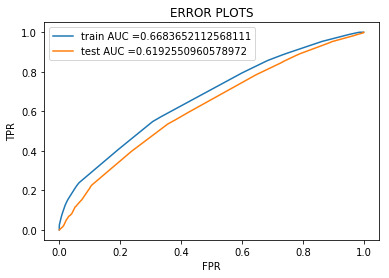

Train confusion matrix
[[ 4949  2473]
 [17821 23798]]
Test confusion matrix
[[ 3394  2112]
 [13478 17068]]


In [0]:
# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_curve.html#sklearn.metrics.roc_curve
from sklearn.metrics import roc_curve, auc


dtree = tree.DecisionTreeClassifier(max_depth=best_dep,min_samples_split=best_nes,class_weight={0 : 0.83 ,1 :0.17})
dtree.fit(bow_train, out_train)
# roc_auc_score(y_true, y_score) the 2nd parameter should be probability estimates of the positive class
# not the predicted outputs

train_fpr, train_tpr, thresholds = roc_curve(out_train, dtree.predict_proba(bow_train)[:,1])
test_fpr, test_tpr, thresholds = roc_curve(out_test, dtree.predict_proba(bow_test)[:,1])

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.title("ERROR PLOTS")
plt.show()

print("="*100)

from sklearn.metrics import confusion_matrix
print("Train confusion matrix")
print(confusion_matrix(out_train, dtree.predict(bow_train)))
print("Test confusion matrix")
print(confusion_matrix(out_test, dtree.predict(bow_test)))

In [0]:
print(type(bow_train))

<class 'scipy.sparse.coo.coo_matrix'>


#### 2.4.1.1 Graphviz visualization of Decision Tree on BOW,<font color='red'> SET 1</font>

In [0]:
# Please write all the code with proper documentation
import graphviz
dot_data = tree.export_graphviz(dtree, out_file=None,  feature_names=features,  
    class_names=['0','1'],  filled=True, rounded=True, special_characters=True) 
graph = graphviz.Source(dot_data)  
graph.render('dtree_render',view=True)

'dtree_render.pdf'

In [0]:
#print(bool(0)&'apple')
from itertools import compress
gt=[0,1,0,1,0,1,2]
gtt=[True,False,True,False,True,False,True,False]



In [0]:
tpred=dtree.predict(bow_test)
falsepos=bow_test.todense()[(out_test==0)&(tpred==1)]


In [0]:
titfalp=falsepos[:,0:2095]
tnumf=np.array(titfalp,dtype=bool)
cloudsent=" "
for se in tqdm(tnumf):
  dfr=""
  ff=list(compress(titbowfea,se))
  print(ff)
  for tg in ff:
    dfr=dfr+" "+tg
    print(dfr)
  cloudsent=cloudsent+" "+dfr
  print(cloudsent)



  3%|▎         | 68/2112 [00:00<00:03, 674.36it/s]

['research', 'stem', 'students', 'teaching']
 research
 research stem
 research stem students
 research stem students teaching
   research stem students teaching
['help', 'our', 'read', 'sight', 'snap', 'us', 'words']
 help
 help our
 help our read
 help our read sight
 help our read sight snap
 help our read sight snap us
 help our read sight snap us words
   research stem students teaching  help our read sight snap us words
['from']
 from
   research stem students teaching  help our read sight snap us words  from
['technology']
 technology
   research stem students teaching  help our read sight snap us words  from  technology
['flexible', 'learners', 'seating']
 flexible
 flexible learners
 flexible learners seating
   research stem students teaching  help our read sight snap us words  from  technology  flexible learners seating
['build', 'help', 'library', 'us']
 build
 build help
 build help library
 build help library us
   research stem students teaching  help our read sight snap

 10%|█         | 213/2112 [00:00<00:02, 694.29it/s]


 books kinders love read storage we
   research stem students teaching  help our read sight snap us words  from  technology  flexible learners seating  build help library us  early starting stem  it like move to we  families help my need read students their to  interactive learning  daily minds stimulating through young  my nook reading  need  games learning math science  get out  one too want we  discovering language the  understanding unlocking  it learn see show  blast math  everybody future now plant  books cozy nook reading with  get in let readers  grow incentives lead learning motivated transform  are leaders readers  learn listen  lessons life  our poverty save school  building  chromebook go where world  teaching technology with  book everyone found not reader yet  mathematics  basketballs  while wobble work you  students technology  first spanish speakers time writer  step tech up  area effective reading students  clean  current events important knowledge  books engaging  ba

 20%|█▉        | 413/2112 [00:00<00:02, 787.52it/s]

 centers chromebooks guided
 centers chromebooks guided math
 centers chromebooks guided math we
 centers chromebooks guided math we would
   research stem students teaching  help our read sight snap us words  from  technology  flexible learners seating  build help library us  early starting stem  it like move to we  families help my need read students their to  interactive learning  daily minds stimulating through young  my nook reading  need  games learning math science  get out  one too want we  discovering language the  understanding unlocking  it learn see show  blast math  everybody future now plant  books cozy nook reading with  get in let readers  grow incentives lead learning motivated transform  are leaders readers  learn listen  lessons life  our poverty save school  building  chromebook go where world  teaching technology with  book everyone found not reader yet  mathematics  basketballs  while wobble work you  students technology  first spanish speakers time writer  step t

 27%|██▋       | 561/2112 [00:00<00:02, 663.82it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 36%|███▋      | 766/2112 [00:01<00:02, 592.52it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 43%|████▎     | 906/2112 [00:01<00:01, 629.50it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.io

In [0]:
textfalp=falsepos[:,2096:14153]
tenum=np.array(textfalp,dtype=bool)
cloudsent1=" "
for se in tqdm(tenum):
  dfw=""
  fe=list(compress(textbowfea,se))
  print(fe)
  for tg in fe:
    dfw=dfw+" "+tg
    print(dfw)
  cloudsent1=cloudsent1+" "+dfw
  print(cloudsent1)

  0%|          | 0/2112 [00:00<?, ?it/s]

['addition', 'addressed', 'affords', 'amazes', 'apathetic', 'bird', 'blindness', 'carefully', 'championship', 'classical', 'comfort', 'composer', 'context', 'courteous', 'creatively', 'creator', 'demonstration', 'deserts', 'engaging', 'enriching', 'excites', 'exciting', 'expects', 'experiential', 'experimental', 'expert', 'exponential', 'fairy', 'fine', 'generation', 'giving', 'hardware', 'helpful', 'hiking', 'hub', 'identifies', 'ideology', 'india', 'insatiable', 'learning', 'leather', 'likes', 'maracas', 'motivation', 'motivational', 'narrative', 'newcomers', 'note', 'ohio', 'online', 'opposite', 'participant', 'participation', 'patients', 'permanently', 'processor', 'productively', 'projector', 'prominent', 'pure', 'quests', 'quickly', 'requiring', 'researches', 'reynolds', 'science', 'scientist', 'specimens', 'step', 'studious', 'supported', 'teammate', 'thinking', 'tornadoes', 'type', 'usb', 'useless', 'users', 'war', 'whys', 'wrap']
 addition
 addition addressed
 addition address

  1%|          | 12/2112 [00:00<00:23, 88.37it/s]


 addition addressed affords amazes apathetic bird blindness carefully championship classical comfort composer context courteous creatively creator demonstration deserts engaging enriching excites exciting expects experiential experimental expert exponential fairy fine generation giving hardware helpful hiking hub identifies ideology india insatiable learning leather likes maracas motivation motivational narrative newcomers note ohio online opposite participant participation patients permanently processor productively projector prominent pure quests quickly requiring researches reynolds science scientist specimens step studious supported teammate thinking
 addition addressed affords amazes apathetic bird blindness carefully championship classical comfort composer context courteous creatively creator demonstration deserts engaging enriching excites exciting expects experiential experimental expert exponential fairy fine generation giving hardware helpful hiking hub identifies ideology i

  1%|          | 23/2112 [00:00<00:32, 64.05it/s]


 activates addressed adverse afford agenda allows amazes ample applying appreciation articulate asd biased bouts chose classical clean completing creative creator de defend demanded deteriorating discovery disengaged educator elapsed encouraging engineer engineers enriching event exclaimed experiential explores fulton functional functioning gadgets grades heartbeat hmong hybrid imagination known landing lapboards leather live mathematician means methodology mini missions morals musicals myplate narrative note novice obvious online orders perform physiology processor putty readers ready realities
 activates addressed adverse afford agenda allows amazes ample applying appreciation articulate asd biased bouts chose classical clean completing creative creator de defend demanded deteriorating discovery disengaged educator elapsed encouraging engineer engineers enriching event exclaimed experiential explores fulton functional functioning gadgets grades heartbeat hmong hybrid imagination kno

  1%|▏         | 30/2112 [00:00<00:31, 65.10it/s]


['2nd', '600', '62', '66', '93', 'academy', 'accelerated', 'address', 'allows', 'alternate', 'approaching', 'avoided', 'bolster', 'bookworms', 'breakoutedu', 'chill', 'classmates', 'companies', 'consideration', 'developments', 'educator', 'ensembles', 'experimental', 'fancy', 'flourishes', 'freeing', 'ghana', 'grades', 'growling', 'handmade', 'hears', 'heartbeat', 'helpful', 'highlighted', 'historic', 'ideology', 'impress', 'inconvenience', 'item', 'kiln', 'knowledgeable', 'last', 'lasts', 'leaving', 'lewis', 'lifestyle', 'lifts', 'lock', 'lovers', 'lowering', 'lungs', 'maintain', 'makeover', 'maracas', 'maze', 'means', 'mentoring', 'miracles', 'narrative', 'needles', 'note', 'numerous', 'partitions', 'perceptual', 'piedmont', 'pleasure', 'posses', 'proposing', 'provisions', 'provoke', 'quantitative', 'reed', 'russia', 'schooling', 'sensors', 'served', 'service', 'sixty', 'skit', 'smartboard', 'specialized', 'stacking', 'staten', 'storyboard', 'strengthens', 'strumming', 'studio', 'st

  2%|▏         | 37/2112 [00:00<00:36, 57.30it/s]


 93
 93 accessing
 93 accessing allows
 93 accessing allows argue
 93 accessing allows argue asl
 93 accessing allows argue asl asleep
 93 accessing allows argue asl asleep attracting
 93 accessing allows argue asl asleep attracting classical
 93 accessing allows argue asl asleep attracting classical cognitively
 93 accessing allows argue asl asleep attracting classical cognitively comfort
 93 accessing allows argue asl asleep attracting classical cognitively comfort con
 93 accessing allows argue asl asleep attracting classical cognitively comfort con concentrated
 93 accessing allows argue asl asleep attracting classical cognitively comfort con concentrated conceptually
 93 accessing allows argue asl asleep attracting classical cognitively comfort con concentrated conceptually continuity
 93 accessing allows argue asl asleep attracting classical cognitively comfort con concentrated conceptually continuity dear
 93 accessing allows argue asl asleep attracting classical cognitively co

  2%|▏         | 42/2112 [00:00<00:38, 53.09it/s]

 activate activists additions advancements aloud ambiance ant anticipated approved arrangements aspect bedford believes bettering bfg buildings butterflies cantonese carefree centuries classical clean collages comfort completing concern connection creates critiques de destroyed differentiates dividing eating endeavors engine enjoyment enticing envision everything explanation expression extras fearless firsts founded freeing fulton functioning gaming goats going greatness groups grove growling guidance helpful henry herb identifies impress informing infrastructure insects introduction kiln knitting knowledgeable learning leather lifestyle loaded looms lovers loves magically
 activate activists additions advancements aloud ambiance ant anticipated approved arrangements aspect bedford believes bettering bfg buildings butterflies cantonese carefree centuries classical clean collages comfort completing concern connection creates critiques de destroyed differentiates dividing eating endeavor

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

  8%|▊         | 170/2112 [00:03<00:39, 49.50it/s]


 102 12 72 abraham accessing aloud backpatter bedding bedroom bengali bfg bikes biking bookworms buildings chicks classical classification clean columbia continuity counselors de differentiates divide dork eagles enriching everything experimental expository faced factory forum genuine goods grades guarantee helpful
 102 12 72 abraham accessing aloud backpatter bedding bedroom bengali bfg bikes biking bookworms buildings chicks classical classification clean columbia continuity counselors de differentiates divide dork eagles enriching everything experimental expository faced factory forum genuine goods grades guarantee helpful impress
 102 12 72 abraham accessing aloud backpatter bedding bedroom bengali bfg bikes biking bookworms buildings chicks classical classification clean columbia continuity counselors de differentiates divide dork eagles enriching everything experimental expository faced factory forum genuine goods grades guarantee helpful impress kiln
 102 12 72 abraham accessin

  8%|▊         | 176/2112 [00:03<00:37, 52.18it/s]


 achiever argue arrangements averages basket beads bedding bettering bookworms buildings carpets citizenship comfort curling de dreamers fine footprint ghana gravitate helpful http johnson kore lacrosse latinos likes lovers
 achiever argue arrangements averages basket beads bedding bettering bookworms buildings carpets citizenship comfort curling de dreamers fine footprint ghana gravitate helpful http johnson kore lacrosse latinos likes lovers maracas
 achiever argue arrangements averages basket beads bedding bettering bookworms buildings carpets citizenship comfort curling de dreamers fine footprint ghana gravitate helpful http johnson kore lacrosse latinos likes lovers maracas midwestern
 achiever argue arrangements averages basket beads bedding bettering bookworms buildings carpets citizenship comfort curling de dreamers fine footprint ghana gravitate helpful http johnson kore lacrosse latinos likes lovers maracas midwestern mini
 achiever argue arrangements averages basket beads b

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

  9%|▉         | 189/2112 [00:03<00:38, 50.53it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 2018 240 504s abraham academy ace achiever action activated acts address aim alaskan alphabetter alternate appetite approaching atypical audiobooks auditorium authority averages behalf beneath bettering bookworms cereal chasing chill classification clean communicators compromise course crystals demographic engaging equitable ethical expecting experimental facts false fancy fans feeds fees fluorescent frisbees galaxy gallon geographical ghana grades graduated growling handwritten helpful
 2018 240 504s abraham academy ace achiever action activated acts address aim alaskan alphabetter alternate appetite approaching atypical audiobooks auditorium authority averages behalf beneath bettering bookworms cereal chasing chill classification clean communicators compromise course crystals demographic engaging equitable ethical expecting experimental facts false fancy fans feeds fees fluorescent frisbees galaxy gallon geographical ghana grades graduated growling handwritten helpful hopeless


 10%|▉         | 201/2112 [00:04<00:49, 38.30it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 10%|▉         | 211/2112 [00:04<00:46, 40.76it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 10%|█         | 221/2112 [00:04<00:46, 40.56it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub


 270 51 73 82 92 93 97 academy accelerate accelerated addition addressed adjustment allows alongs aloud alternate amazes ambiance ample arguing backed balance bedding bengali bikes booklet bookworms browse bulb celebration chicks circuits classical collaborators comfort consoles context contribution counselors courageous dedicate differentiate disconnect divide donors empathize emphasizing employed endeavors enjoyment entails entertained envision essence everything excel exceptionally exclusive exert experiential fairy fifteen formulate freeing gang gifted giving glamorous goats god grades graduate graduated guarantee hardly illnesses impacts importance impoverished improving inclusive incorporated increasingly influential involve joints kindergartner kindle learnings leather lifestyle loud lungs magazines mall maracas marble mercy metallic midwestern narrative nationwide negatives norms note online oppositional organs ounce parks partnership percentage planets played playstix pockets

 32%|███▏      | 672/2112 [00:13<00:44, 32.03it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 37%|███▋      | 790/2112 [00:16<00:31, 41.39it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 38%|███▊      | 807/2112 [00:16<00:26, 49.67it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub

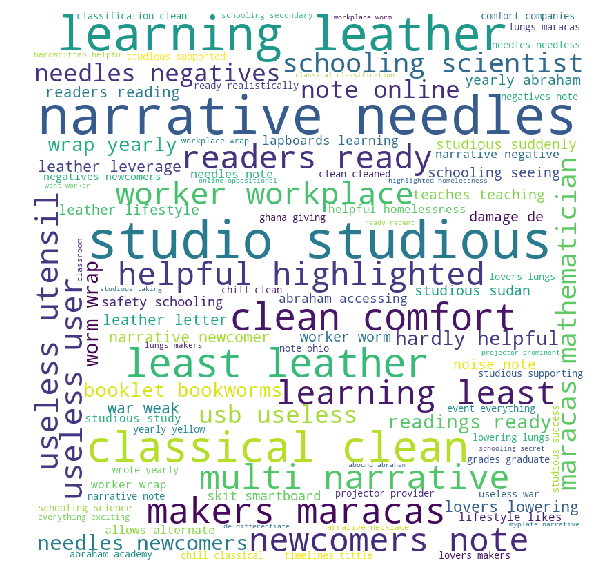

In [0]:
from wordcloud import WordCloud, STOPWORDS 
import matplotlib.pyplot as plt
comment_words=cloudsent+" "+cloudsent1
stopwords = set(STOPWORDS)
wordcloud = WordCloud(width = 800, height = 800, 
				background_color ='white', 
				stopwords = stopwords, 
				min_font_size = 10).generate(comment_words) 

# plot the WordCloud image					 
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0)

### 2.4.2 Applying Decision Trees on TFIDF,<font color='red'> SET 2</font>

In [0]:
# Please write all the code with proper documentation
from sklearn import tree
from sklearn.metrics import roc_auc_score
import matplotlib.pyplot as plt
train_auc = []
cv_auc = []
c = [4,6, 8, 9,10,12,14,17]
s=[2,10,20,30,40,50]
for i in tqdm(c):
  for h in tqdm(s):
    dtree = tree.DecisionTreeClassifier(max_depth=i,min_samples_split=h,class_weight={0 : 0.83 ,1 :0.17})
    dtree.fit(tfidf_train, out_train)
    y_train_pred =  dtree.predict_proba(tfidf_train)[:,1]
    y_cv_pred =  dtree.predict_proba(tfidf_cv)[:,1]
    train_auc.append(roc_auc_score(out_train,y_train_pred))
    cv_auc.append(roc_auc_score(out_cv, y_cv_pred))


100%|██████████| 8/8 [09:43<00:00, 98.12s/it]


In [0]:
cc=[4,4,4,4,4,4,6,6,6,6,6,6,8,8,8,8,8,8,9,9,9,9,9,9,10,10,10,10,10,10,12,12,12,12,12,12,14,14,14,14,14,14,17,17,17,17,17,17]
ss=[2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50]
trace1 = go.Scatter3d(x=cc,y=ss,z=train_auc, name = 'train')
trace2 = go.Scatter3d(x=cc,y=ss,z=cv_auc, name = 'Cross validation')
data = [trace1, trace2]
enable_plotly_in_cell()

layout = go.Layout(scene = dict(
        xaxis = dict(title='max_depth'),
        yaxis = dict(title='n_estimators'),
        zaxis = dict(title='AUC')))

fig = go.Figure(data=data, layout=layout)
fig.update_layout(scene_aspectmode='manual',
                  scene_aspectratio=dict(x=1, y=1, z=1))
offline.iplot(fig, filename='3d-scatter-colorscale')

In [0]:
# https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html
from sklearn.model_selection import GridSearchCV
from sklearn import tree

dtree = tree.DecisionTreeClassifier(class_weight={0 : 0.83 ,1 :0.17})
parameters = {"max_depth" : [4,6, 8, 9,10,12,14,17],"min_samples_split":[2,10,20,30,40,50]}
clf = GridSearchCV(dtree, parameters, cv=3, scoring='roc_auc',return_train_score=True,verbose=5)
clf.fit(tfidf_train, out_train)
train_auc= clf.cv_results_['mean_train_score']
cv_auc = clf.cv_results_['mean_test_score'] 
#plt.plot(c, train_auc, label='Train AUC')
#plt.plot(c, cv_auc, label='CV AUC')

best_dep=clf.best_params_['max_depth']
best_nes=clf.best_params_['min_samples_split']

Fitting 3 folds for each of 48 candidates, totalling 144 fits
[CV] max_depth=4, min_samples_split=2 ................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[CV]  max_depth=4, min_samples_split=2, score=(train=0.614, test=0.601), total=   2.2s
[CV] max_depth=4, min_samples_split=2 ................................


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.3s remaining:    0.0s


[CV]  max_depth=4, min_samples_split=2, score=(train=0.619, test=0.607), total=   2.2s
[CV] max_depth=4, min_samples_split=2 ................................


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    4.6s remaining:    0.0s


[CV]  max_depth=4, min_samples_split=2, score=(train=0.609, test=0.589), total=   2.2s
[CV] max_depth=4, min_samples_split=10 ...............................


[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    6.8s remaining:    0.0s


[CV]  max_depth=4, min_samples_split=10, score=(train=0.614, test=0.601), total=   2.2s
[CV] max_depth=4, min_samples_split=10 ...............................


[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    9.0s remaining:    0.0s


[CV]  max_depth=4, min_samples_split=10, score=(train=0.619, test=0.607), total=   2.2s
[CV] max_depth=4, min_samples_split=10 ...............................
[CV]  max_depth=4, min_samples_split=10, score=(train=0.609, test=0.589), total=   2.2s
[CV] max_depth=4, min_samples_split=20 ...............................
[CV]  max_depth=4, min_samples_split=20, score=(train=0.614, test=0.601), total=   2.2s
[CV] max_depth=4, min_samples_split=20 ...............................
[CV]  max_depth=4, min_samples_split=20, score=(train=0.619, test=0.607), total=   2.2s
[CV] max_depth=4, min_samples_split=20 ...............................
[CV]  max_depth=4, min_samples_split=20, score=(train=0.609, test=0.589), total=   2.2s
[CV] max_depth=4, min_samples_split=30 ...............................
[CV]  max_depth=4, min_samples_split=30, score=(train=0.614, test=0.601), total=   2.2s
[CV] max_depth=4, min_samples_split=30 ...............................
[CV]  max_depth=4, min_samples_split=30, score

[Parallel(n_jobs=1)]: Done 144 out of 144 | elapsed: 16.6min finished


In [0]:
trace1 = go.Scatter3d(x=cc,y=ss,z=train_auc, name = 'train')
trace2 = go.Scatter3d(x=cc,y=ss,z=cv_auc, name = 'Cross validation')
data = [trace1, trace2]
enable_plotly_in_cell()

layout = go.Layout(scene = dict(
        xaxis = dict(title='max_depth'),
        yaxis = dict(title='n_estimators'),
        zaxis = dict(title='AUC')))

fig = go.Figure(data=data, layout=layout)
fig.update_layout(scene_aspectmode='manual',
                  scene_aspectratio=dict(x=1, y=1, z=1))
offline.iplot(fig, filename='3d-scatter-colorscale')

In [0]:
gh=best_dep
fg=best_nes

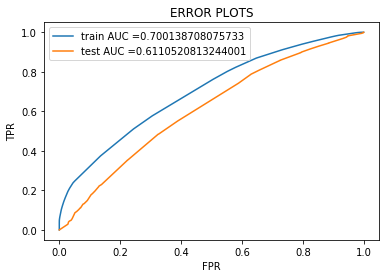

Train confusion matrix
[[ 3673  3749]
 [ 9917 31702]]
Test confusion matrix
[[ 2264  3242]
 [ 7874 22672]]


In [0]:
# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_curve.html#sklearn.metrics.roc_curve
from sklearn.metrics import roc_curve, auc


dtree = tree.DecisionTreeClassifier(max_depth=best_dep,min_samples_split=best_nes,class_weight={0 : 0.83 ,1 :0.17})
dtree.fit(tfidf_train, out_train)
# roc_auc_score(y_true, y_score) the 2nd parameter should be probability estimates of the positive class
# not the predicted outputs

train_fpr, train_tpr, thresholds = roc_curve(out_train, dtree.predict_proba(tfidf_train)[:,1])
test_fpr, test_tpr, thresholds = roc_curve(out_test, dtree.predict_proba(tfidf_test)[:,1])

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.title("ERROR PLOTS")
plt.show()

print("="*100)

from sklearn.metrics import confusion_matrix
print("Train confusion matrix")
print(confusion_matrix(out_train, dtree.predict(tfidf_train)))
print("Test confusion matrix")
print(confusion_matrix(out_test, dtree.predict(tfidf_test)))

#### 2.4.2.1 Graphviz visualization of Decision Tree on TFIDF,<font color='red'> SET 2</font>

In [0]:
dot_data = tree.export_graphviz(dtree, out_file=None,  feature_names=featf,  
    class_names=['0','1'],  filled=True, rounded=True, special_characters=True) 
graph = graphviz.Source(dot_data)  
graph.render('dtree_rendertf',view=True)

'dtree_rendertf.pdf'

In [0]:
tpred=dtree.predict(bow_test)
falsepos=bow_test.todense()[(out_test==0)&(tpred==1)]


In [0]:
titfalp=falsepos[:,0:2095]
tnumf=np.array(titfalp,dtype=bool)
cloudsent=" "
for se in tnumf:
  dfr=""
  ff=list(compress(titifea,se))
  for tg in ff:
    dfr=dfr+" "+tg
  cloudsent=cloudsent+" "+dfr

In [0]:
textfalp=falsepos[:,2096:14153]
tenum=np.array(textfalp,dtype=bool)
cloudsent1=" "
for se in tqdm(tenum):
  dfw=""
  fe=list(compress(textffea,se))
  for tg in fe:
    dfw=dfw+" "+tg
  cloudsent1=cloudsent1+" "+dfw

100%|██████████| 2313/2313 [00:01<00:00, 1838.84it/s]


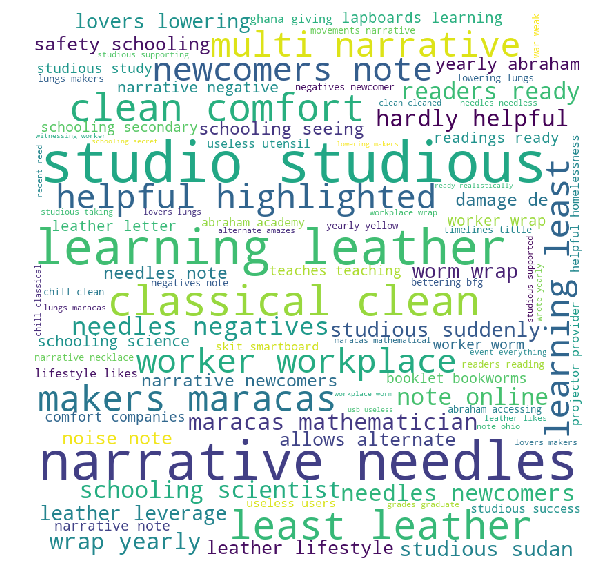

In [0]:
from wordcloud import WordCloud, STOPWORDS 
import matplotlib.pyplot as plt
comment_words=cloudsent+" "+cloudsent1
stopwords = set(STOPWORDS)
wordcloud = WordCloud(width = 800, height = 800, 
				background_color ='white', 
				stopwords = stopwords, 
				min_font_size = 10).generate(comment_words) 

# plot the WordCloud image					 
plt.figure(figsize = (8, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0)

### 2.4.3 Applying Decision Trees on AVG W2V,<font color='red'> SET 3</font>

In [0]:
# Please write all the code with proper documentation
from sklearn import tree
from sklearn.metrics import roc_auc_score
import matplotlib.pyplot as plt
train_auc = []
cv_auc = []
c = [4,6, 8, 9,10,12,14,17]
s=[2,10,20,30,40,50]
for i in tqdm(c):
  for h in tqdm(s):
    dtree = tree.DecisionTreeClassifier(max_depth=i,min_samples_split=h,class_weight={0 : 0.83 ,1 :0.17})
    dtree.fit(avg_w2v_train, out_train)
    y_train_pred =  dtree.predict_proba(avg_w2v_train)[:,1]
    y_cv_pred =  dtree.predict_proba(avg_w2v_cv)[:,1]
    train_auc.append(roc_auc_score(out_train,y_train_pred))
    cv_auc.append(roc_auc_score(out_cv, y_cv_pred))


100%|██████████| 8/8 [1:02:22<00:00, 604.81s/it]


In [0]:
cc=[4,4,4,4,4,4,6,6,6,6,6,6,8,8,8,8,8,8,9,9,9,9,9,9,10,10,10,10,10,10,12,12,12,12,12,12,14,14,14,14,14,14,17,17,17,17,17,17]
ss=[2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50]
trace1 = go.Scatter3d(x=cc,y=ss,z=train_auc, name = 'train')
trace2 = go.Scatter3d(x=cc,y=ss,z=cv_auc, name = 'Cross validation')
data = [trace1, trace2]
enable_plotly_in_cell()

layout = go.Layout(scene = dict(
        xaxis = dict(title='max_depth'),
        yaxis = dict(title='n_estimators'),
        zaxis = dict(title='AUC')))

fig = go.Figure(data=data, layout=layout)
fig.update_layout(scene_aspectmode='manual',
                  scene_aspectratio=dict(x=1, y=1, z=1))
offline.iplot(fig, filename='3d-scatter-colorscale')

In [0]:
# https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html
from sklearn.model_selection import GridSearchCV

dtree = tree.DecisionTreeClassifier(class_weight={0 : 0.83 ,1 :0.17})
parameters = {"max_depth" : [4,6, 8, 9,10,12,14,17],"min_samples_split":[2,10,20,30,40,50]}
clf = GridSearchCV(dtree, parameters, cv=3, scoring='roc_auc',return_train_score=True,verbose=5,n_jobs=-1)
clf.fit(avg_w2v_train, out_train)
train_auc= clf.cv_results_['mean_train_score']
cv_auc = clf.cv_results_['mean_test_score'] 
#plt.plot(c, train_auc, label='Train AUC')
#plt.plot(c, cv_auc, label='CV AUC')

best_dep=clf.best_params_['max_depth']
best_nes=clf.best_params_['min_samples_split']

Fitting 3 folds for each of 48 candidates, totalling 144 fits
[CV] max_depth=4, min_samples_split=2 ................................


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[CV]  max_depth=4, min_samples_split=2, score=(train=0.634, test=0.610), total=  13.2s
[CV] max_depth=4, min_samples_split=2 ................................


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   13.3s remaining:    0.0s


[CV]  max_depth=4, min_samples_split=2, score=(train=0.631, test=0.606), total=  13.2s
[CV] max_depth=4, min_samples_split=2 ................................


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   26.7s remaining:    0.0s


[CV]  max_depth=4, min_samples_split=2, score=(train=0.638, test=0.595), total=  13.2s
[CV] max_depth=4, min_samples_split=10 ...............................


[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:   40.0s remaining:    0.0s


[CV]  max_depth=4, min_samples_split=10, score=(train=0.634, test=0.610), total=  13.0s
[CV] max_depth=4, min_samples_split=10 ...............................


[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   53.2s remaining:    0.0s


[CV]  max_depth=4, min_samples_split=10, score=(train=0.631, test=0.606), total=  13.3s
[CV] max_depth=4, min_samples_split=10 ...............................
[CV]  max_depth=4, min_samples_split=10, score=(train=0.638, test=0.595), total=  13.2s
[CV] max_depth=4, min_samples_split=20 ...............................
[CV]  max_depth=4, min_samples_split=20, score=(train=0.634, test=0.610), total=  13.1s
[CV] max_depth=4, min_samples_split=20 ...............................
[CV]  max_depth=4, min_samples_split=20, score=(train=0.631, test=0.606), total=  13.1s
[CV] max_depth=4, min_samples_split=20 ...............................
[CV]  max_depth=4, min_samples_split=20, score=(train=0.638, test=0.595), total=  13.1s
[CV] max_depth=4, min_samples_split=30 ...............................
[CV]  max_depth=4, min_samples_split=30, score=(train=0.634, test=0.610), total=  13.5s
[CV] max_depth=4, min_samples_split=30 ...............................
[CV]  max_depth=4, min_samples_split=30, score

[Parallel(n_jobs=1)]: Done 144 out of 144 | elapsed: 112.7min finished


In [0]:
trace1 = go.Scatter3d(x=cc,y=ss,z=train_auc, name = 'train')
trace2 = go.Scatter3d(x=cc,y=ss,z=cv_auc, name = 'Cross validation')
data = [trace1, trace2]
enable_plotly_in_cell()

layout = go.Layout(scene = dict(
        xaxis = dict(title='max_depth'),
        yaxis = dict(title='n_estimators'),
        zaxis = dict(title='AUC')))

fig = go.Figure(data=data, layout=layout)
fig.update_layout(scene_aspectmode='manual',
                  scene_aspectratio=dict(x=1, y=1, z=1))
offline.iplot(fig, filename='3d-scatter-colorscale')

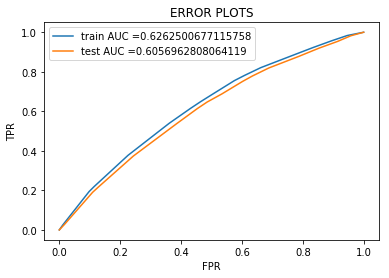

Train confusion matrix
[[ 3117  4226]
 [10195 31503]]
Test confusion matrix
[[ 2190  3313]
 [ 7604 22945]]


In [0]:
# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_curve.html#sklearn.metrics.roc_curve
from sklearn.metrics import roc_curve, auc


dtree = tree.DecisionTreeClassifier(max_depth=best_dep,min_samples_split=best_nes,class_weight={0 : 0.83 ,1 :0.17})
dtree.fit(avg_w2v_train, out_train)
# roc_auc_score(y_true, y_score) the 2nd parameter should be probability estimates of the positive class
# not the predicted outputs

train_fpr, train_tpr, thresholds = roc_curve(out_train, dtree.predict_proba(avg_w2v_train)[:,1])
test_fpr, test_tpr, thresholds = roc_curve(out_test, dtree.predict_proba(avg_w2v_test)[:,1])

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.title("ERROR PLOTS")
plt.show()

print("="*100)

from sklearn.metrics import confusion_matrix
print("Train confusion matrix")
print(confusion_matrix(out_train, dtree.predict(avg_w2v_train)))
print("Test confusion matrix")
print(confusion_matrix(out_test, dtree.predict(avg_w2v_test)))

### 2.4.4 Applying Decision Trees on TFIDF W2V,<font color='red'> SET 4</font>

In [0]:
# Please write all the code with proper documentation
from sklearn import tree
from sklearn.metrics import roc_auc_score
import matplotlib.pyplot as plt
train_auc = []
cv_auc = []
c = [4,6, 8, 9,10,12,14,17]
s=[2,10,20,30,40,50]
for i in tqdm(c):
  for h in tqdm(s):
    dtree = tree.DecisionTreeClassifier(max_depth=i,min_samples_split=h,class_weight={0 : 0.83 ,1 :0.17})
    dtree.fit(tif_w2v_train, out_train)
    y_train_pred =  dtree.predict_proba(tif_w2v_train)[:,1]
    y_cv_pred =  dtree.predict_proba(tif_w2v_cv)[:,1]
    train_auc.append(roc_auc_score(out_train,y_train_pred))
    cv_auc.append(roc_auc_score(out_cv, y_cv_pred))


100%|██████████| 8/8 [1:02:40<00:00, 609.69s/it]


In [0]:
cc=[4,4,4,4,4,4,6,6,6,6,6,6,8,8,8,8,8,8,9,9,9,9,9,9,10,10,10,10,10,10,12,12,12,12,12,12,14,14,14,14,14,14,17,17,17,17,17,17]
ss=[2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50,2,10,20,30,40,50]
trace1 = go.Scatter3d(x=cc,y=ss,z=train_auc, name = 'train')
trace2 = go.Scatter3d(x=cc,y=ss,z=cv_auc, name = 'Cross validation')
data = [trace1, trace2]
enable_plotly_in_cell()

layout = go.Layout(scene = dict(
        xaxis = dict(title='max_depth'),
        yaxis = dict(title='n_estimators'),
        zaxis = dict(title='AUC')))

fig = go.Figure(data=data, layout=layout)
fig.update_layout(scene_aspectmode='manual',
                  scene_aspectratio=dict(x=1, y=1, z=1))
offline.iplot(fig, filename='3d-scatter-colorscale')

In [0]:
# https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html
from sklearn.model_selection import GridSearchCV

dtree = tree.DecisionTreeClassifier(class_weight={0 : 0.83 ,1 :0.17})
parameters = {"max_depth" : [4,6, 8, 9,10,12,14,17],"min_samples_split":[2,10,20,30,40,50]}
clf = GridSearchCV(dtree, parameters, cv=3, scoring='roc_auc',return_train_score=True,verbose=5,n_jobs=-1)
clf.fit(tif_w2v_train, out_train)
train_auc= clf.cv_results_['mean_train_score']
cv_auc = clf.cv_results_['mean_test_score'] 
#plt.plot(c, train_auc, label='Train AUC')
#plt.plot(c, cv_auc, label='CV AUC')

best_dep=clf.best_params_['max_depth']
best_nes=clf.best_params_['min_samples_split']

Fitting 3 folds for each of 48 candidates, totalling 144 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  2.4min
[Parallel(n_jobs=-1)]: Done  68 tasks      | elapsed: 23.3min
[Parallel(n_jobs=-1)]: Done 144 out of 144 | elapsed: 83.3min finished


In [0]:
trace1 = go.Scatter3d(x=cc,y=ss,z=train_auc, name = 'train')
trace2 = go.Scatter3d(x=cc,y=ss,z=cv_auc, name = 'Cross validation')
data = [trace1, trace2]
enable_plotly_in_cell()

layout = go.Layout(scene = dict(
        xaxis = dict(title='max_depth'),
        yaxis = dict(title='n_estimators'),
        zaxis = dict(title='AUC')))

fig = go.Figure(data=data, layout=layout)
fig.update_layout(scene_aspectmode='manual',
                  scene_aspectratio=dict(x=1, y=1, z=1))
offline.iplot(fig, filename='3d-scatter-colorscale')

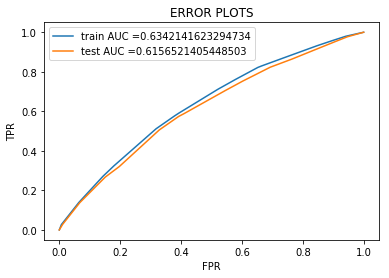

Train confusion matrix
[[ 3094  4249]
 [ 9964 31734]]
Test confusion matrix
[[ 2185  3318]
 [ 7544 23005]]


In [0]:
# https://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_curve.html#sklearn.metrics.roc_curve
from sklearn.metrics import roc_curve, auc


dtree = tree.DecisionTreeClassifier(max_depth=best_dep,min_samples_split=best_nes,class_weight={0 : 0.83 ,1 :0.17})
dtree.fit(tif_w2v_train, out_train)
# roc_auc_score(y_true, y_score) the 2nd parameter should be probability estimates of the positive class
# not the predicted outputs

train_fpr, train_tpr, thresholds = roc_curve(out_train, dtree.predict_proba(tif_w2v_train)[:,1])
test_fpr, test_tpr, thresholds = roc_curve(out_test, dtree.predict_proba(tif_w2v_test)[:,1])

plt.plot(train_fpr, train_tpr, label="train AUC ="+str(auc(train_fpr, train_tpr)))
plt.plot(test_fpr, test_tpr, label="test AUC ="+str(auc(test_fpr, test_tpr)))
plt.legend()
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.title("ERROR PLOTS")
plt.show()

print("="*100)

from sklearn.metrics import confusion_matrix
print("Train confusion matrix")
print(confusion_matrix(out_train, dtree.predict(tif_w2v_train)))
print("Test confusion matrix")
print(confusion_matrix(out_test, dtree.predict(tif_w2v_test)))

<h2>2.5 [Task-2]Getting top 5k features using `feature_importances_`</h2>

In [0]:
dtree = tree.DecisionTreeClassifier(max_depth=gh,min_samples_split=fg,class_weight={0 : 0.83 ,1 :0.17})
dtree.fit(tfidf_train, out_train)
feat=dtree.feature_importances_
print(feat.shape)

(14219,)


In [0]:
#https://stackoverflow.com/questions/6910641/how-do-i-get-indices-of-n-maximum-values-in-a-numpy-array
import heapq
feai=heapq.nlargest(5000, range(len(feat)), feat.take)
feai.sort()
feai=np.array(feai)
tem=tfidf_train
tem=pd.DataFrame(tem.toarray())

#
#print(new_tfidf_train)

In [0]:
new_tfidf_train=tem.iloc[:,feai]

In [0]:
tem.head(10)

NameError: ignored

<h1>3. Conclusion</h1>

In [0]:
# Please compare all your models using Prettytable library